# Computational Linear Algebra: PCA Homework

## Initialization:
Fill the missing values in this text box and in the following code-cell.

**Academic Year:** 2024/2025

### Team Members (Alphabetical Order):
1. Bono, Giorgio (343572);
2. Camolese, Claudio (344788).

In [59]:
StudentID1 = 343572
StudentID2 = 344788

## Starting Code-Cell 
### Attention: DO NOT CHANGE THE CODE INSIDE THE FOLLOWING CELL!

In [60]:
####################################################################
############## DO NOT CHANGE THE CODE IN THIS CELL #################
####################################################################

import numpy as np

var_entertainment_feat_types = ['Interests', 'Movies', 'Music']
var_personal_feat_types = ['Finance', 'Phobias']
fixed_feat_types = ['Personality', 'Health']

label_types = ['Demographic']

variables_by_type = {
    'Demographics': ['Age', 'Height', 'Weight', 'Number of siblings', 
                     'Gender', 'Hand', 'Education', 'Only child', 'Home Town Type',
                     'Home Type'],
    'Finance': ['Finances', 'Shopping centres', 'Branded clothing', 
                'Entertainment spending', 'Spending on looks', 
                'Spending on gadgets', 'Spending on healthy eating'],
    'Health': ['Smoking', 'Alcohol', 'Healthy eating'],
    'Interests': ['History', 'Psychology', 'Politics', 'Mathematics', 
                  'Physics', 'Internet', 'PC', 'Economy Management', 
                  'Biology', 'Chemistry', 'Reading', 'Geography', 
                  'Foreign languages', 'Medicine', 'Law', 'Cars', 
                  'Art exhibitions', 'Religion', 'Countryside, outdoors', 
                  'Dancing', 'Musical instruments', 'Writing', 'Passive sport', 
                  'Active sport', 'Gardening', 'Celebrities', 'Shopping', 
                  'Science and technology', 'Theatre', 'Fun with friends', 
                  'Adrenaline sports', 'Pets'],
    'Movies': ['Movies', 'Horror', 'Thriller', 'Comedy', 'Romantic', 
               'Sci-fi', 'War', 'Fantasy/Fairy tales', 'Animated', 
               'Documentary', 'Western', 'Action'],
    'Music': ['Music', 'Slow songs or fast songs', 'Dance', 'Folk', 
              'Country', 'Classical music', 'Musical', 'Pop', 'Rock', 
              'Metal or Hardrock', 'Punk', 'Hiphop, Rap', 'Reggae, Ska', 
              'Swing, Jazz', 'Rock n roll', 'Alternative', 'Latino', 
              'Techno, Trance', 'Opera'],
    'Personality': ['Daily events', 'Prioritising workload', 
                    'Writing notes', 'Workaholism', 'Thinking ahead', 
                    'Final judgement', 'Reliability', 'Keeping promises', 
                    'Loss of interest', 'Friends versus money', 'Funniness', 
                    'Fake', 'Criminal damage', 'Decision making', 'Elections', 
                    'Self-criticism', 'Judgment calls', 'Hypochondria', 
                    'Empathy', 'Eating to survive', 'Giving', 
                    'Compassion to animals', 'Borrowed stuff', 
                    'Loneliness', 'Cheating in school', 'Health', 
                    'Changing the past', 'God', 'Dreams', 'Charity', 
                    'Number of friends', 'Punctuality', 'Lying', 'Waiting', 
                    'New environment', 'Mood swings', 'Appearence and gestures', 
                    'Socializing', 'Achievements', 'Responding to a serious letter', 
                    'Children', 'Assertiveness', 'Getting angry', 
                    'Knowing the right people', 'Public speaking', 
                    'Unpopularity', 'Life struggles', 'Happiness in life', 
                    'Energy levels', 'Small - big dogs', 'Personality', 
                    'Finding lost valuables', 'Getting up', 'Interests or hobbies', 
                    "Parents' advice", 'Questionnaires or polls', 'Internet usage'],
    'Phobias': ['Flying', 'Storm', 'Darkness', 'Heights', 'Spiders', 'Snakes', 
                'Rats', 'Ageing', 'Dangerous dogs', 'Fear of public speaking']
}

labels = variables_by_type['Demographics']

try:
    random_seed = min([StudentID1, StudentID2])
except NameError:
    random_seed = StudentID1

def which_featgroups():
    np.random.seed(random_seed)
    these_entertainments = np.random.choice(var_entertainment_feat_types, 2, replace=False).tolist()
    these_personal = np.random.choice(var_personal_feat_types, 1, replace=False).tolist()
    these_types = fixed_feat_types + these_personal + these_entertainments
    print('*** THESE ARE THE SELECTED TYPE OF VARIABLES:')
    for k in these_types:
        print(f'{k}')
    print('*************************************')
    return these_types

def which_features(these_types):
    np.random.seed(random_seed)
    these_features = []
    for type in these_types:
        if type != 'Personality':
            these_features += variables_by_type[type]
        else:
            these_features += np.random.choice(variables_by_type[type], 
                                               int(2 * (len(variables_by_type[type]) / 3)), 
                                               replace=False).tolist()
    print('*** THESE ARE THE SELECTED FEATURES:')
    for ft in these_features:
        print(f'{ft}')
    print('*************************************')
    return these_features

these_types = which_featgroups()
these_features = which_features(these_types)

np.random.seed(random_seed)

*** THESE ARE THE SELECTED TYPE OF VARIABLES:
Personality
Health
Phobias
Movies
Music
*************************************
*** THESE ARE THE SELECTED FEATURES:
Internet usage
Giving
Prioritising workload
Parents' advice
Thinking ahead
Children
Workaholism
Punctuality
Energy levels
Changing the past
Happiness in life
Decision making
Charity
Reliability
Personality
Cheating in school
Appearence and gestures
Health
New environment
Getting up
Interests or hobbies
Life struggles
Assertiveness
Empathy
Achievements
Friends versus money
Compassion to animals
Lying
Keeping promises
Writing notes
Final judgement
Small - big dogs
Hypochondria
Self-criticism
Waiting
Dreams
Unpopularity
Funniness
Smoking
Alcohol
Healthy eating
Flying
Storm
Darkness
Heights
Spiders
Snakes
Rats
Ageing
Dangerous dogs
Fear of public speaking
Movies
Horror
Thriller
Comedy
Romantic
Sci-fi
War
Fantasy/Fairy tales
Animated
Documentary
Western
Action
Music
Slow songs or fast songs
Dance
Folk
Country
Classical music
Musical

## Importing Modules

In the following cell, import all the modules you think are necessary for doing the homework, **among the ones listed and used during the laboratories of the course**.
No extra modules are allowed for reproducibility.

In [61]:
%matplotlib widget

import pandas as pd
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
import matplotlib.pyplot as plt
from matplotlib import cm
from matplotlib.lines import Line2D
from IPython.display import display

pd.options.display.max_rows = 10
pd.options.display.max_columns = 82
plt.rcParams['figure.max_open_warning'] = 0

## Exercise 1. Preparing the Dataset

In the cells below, do the following operations:
1. load the dataset "_responses_hw.csv_";
2. create a working dataframe extracting from _responses_hw.csv_ the columns corresponding to the variables in _these_features_, and randomly selecting 2/3 of the rows. Let us call this dataframe _X_df_;
3. analyze the obtained dataframe and performing cleansing/encoding operations.

## Exercise 1.1 Load the dataset

In [62]:
response_df = pd.read_csv("responses_hw.csv")
response_df

,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,Punk,"Hiphop, Rap","Reggae, Ska","Swing, Jazz",Rock n roll,Alternative,Latino,"Techno, Trance",Opera,Movies,Horror,Thriller,Comedy,Romantic,Sci-fi,War,Fantasy/Fairy tales,Animated,Documentary,Western,Action,History,Psychology,Politics,Mathematics,Physics,Internet,PC,Economy Management,Biology,Chemistry,...,Waiting,New environment,Mood swings,Appearence and gestures,Socializing,Achievements,Responding to a serious letter,Children,Assertiveness,Getting angry,Knowing the right people,Public speaking,Unpopularity,Life struggles,Happiness in life,Energy levels,Small - big dogs,Personality,Finding lost valuables,Getting up,Interests or hobbies,Parents' advice,Questionnaires or polls,Internet usage,Finances,Shopping centres,Branded clothing,Entertainment spending,Spending on looks,Spending on gadgets,Spending on healthy eating,Age,Height,Weight,Number of siblings,Gender,Hand,Education,Only child,Home Town Type,Home Type
0,5.0,3.0,2.0,1.0,2.0,2.0,1.0,5.0,5.0,1.0,1.0,1.0,1.0,1.0,3.0,1.0,1.0,1.0,1.0,5.0,4.0,2.0,5.0,4.0,4.0,1.0,5.0,5.0,3.0,1.0,2.0,1.0,5.0,1.0,3.0,3.0,5.0,3.0,5.0,3.0,3.0,...,3.0,4.0,3.0,4.0,3.0,4.0,3.0,5.0,1.0,1.0,3.0,5.0,5.0,1.0,4.0,5.0,1.0,4.0,3.0,2.0,3.0,4.0,3.0,few hours a day,3.0,4.0,5.0,3.0,3.0,1,3.0,20.0,163.0,48.0,1.0,female,right,college/bachelor degree,no,village,block of flats
1,4.0,4.0,2.0,1.0,1.0,1.0,2.0,3.0,5.0,4.0,4.0,1.0,3.0,1.0,4.0,4.0,2.0,1.0,1.0,5.0,2.0,2.0,4.0,3.0,4.0,1.0,3.0,5.0,4.0,1.0,4.0,1.0,3.0,4.0,5.0,2.0,4.0,4.0,5.0,1.0,1.0,...,3.0,4.0,4.0,4.0,4.0,2.0,4.0,2.0,2.0,5.0,4.0,4.0,4.0,1.0,4.0,3.0,5.0,3.0,4.0,5.0,3.0,2.0,3.0,few hours a day,3.0,4.0,1.0,4.0,2.0,5,2.0,19.0,163.0,58.0,2.0,female,right,college/bachelor degree,no,city,block of flats
2,5.0,5.0,2.0,2.0,3.0,4.0,5.0,3.0,5.0,3.0,4.0,1.0,4.0,3.0,5.0,5.0,5.0,1.0,3.0,5.0,3.0,4.0,4.0,2.0,4.0,2.0,5.0,5.0,2.0,2.0,1.0,1.0,2.0,1.0,5.0,2.0,4.0,2.0,4.0,1.0,1.0,...,2.0,3.0,4.0,3.0,5.0,3.0,4.0,4.0,3.0,4.0,3.0,2.0,4.0,4.0,4.0,4.0,3.0,3.0,3.0,4.0,5.0,3.0,1.0,few hours a day,2.0,4.0,1.0,4.0,3.0,4,2.0,20.0,176.0,67.0,2.0,female,right,secondary school,no,city,block of flats
3,5.0,3.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0,4.0,2.0,2.0,1.0,2.0,5.0,1.0,2.0,1.0,5.0,4.0,4.0,3.0,3.0,4.0,3.0,1.0,2.0,5.0,1.0,2.0,4.0,4.0,5.0,4.0,1.0,3.0,1.0,2.0,3.0,3.0,...,1.0,1.0,5.0,3.0,1.0,3.0,3.0,2.0,5.0,5.0,4.0,5.0,3.0,3.0,2.0,2.0,1.0,2.0,1.0,1.0,NaN,2.0,4.0,most of the day,2.0,4.0,3.0,3.0,4.0,4,1.0,22.0,172.0,59.0,1.0,female,right,college/bachelor degree,yes,city,house/bungalow
4,5.0,3.0,4.0,3.0,2.0,4.0,3.0,5.0,3.0,1.0,2.0,5.0,3.0,2.0,1.0,2.0,4.0,2.0,2.0,5.0,4.0,4.0,5.0,2.0,3.0,3.0,4.0,4.0,3.0,1.0,4.0,3.0,2.0,3.0,2.0,2.0,2.0,2.0,2.0,3.0,3.0,...,3.0,4.0,2.0,3.0,3.0,3.0,3.0,5.0,4.0,2.0,3.0,5.0,5.0,2.0,3.0,5.0,3.0,3.0,2.0,4.0,3.0,3.0,3.0,few hours a day,4.0,3.0,4.0,3.0,3.0,2,4.0,20.0,170.0,59.0,1.0,female,right,secondary school,no,village,house/bungalow
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1005,5.0,2.0,5.0,2.0,2.0,5.0,4.0,4.0,4.0,3.0,2.0,4.0,1.0,5.0,4.0,4.0,3.0,3.0,2.0,5.0,2.0,3.0,4.0,5.0,4.0,2.0,5.0,5.0,2.0,1.0,4.0,4.0,4.0,2.0,1.0,2.0,4.0,3.0,1.0,2.0,1.0,...,2.0,4.0,3.0,4.0,4.0,3.0,4.0,3.0,2.0,2.0,4.0,5.0,4.0,4.0,4.0,3.0,3.0,3.0,4.0,5.0,4.0,4.0,3.0,few hours a day,3.0,5.0,4.0,3.0,4.0,3,4.0,20.0,164.0,57.0,1.0,female,right,secondary school,no,city,house/bungalow
1006,4.0,4.0,5.0,1.0,3.0,4.0,1.0,4.0,1.0,1.0,4.0,1.0,1.0,2.0,3.0,1.0,3.0,4.0,1.0,5.0,2.0,5.0,5.0,1.0,5.0,5.0,1.0,5.0,5.0,2.0,5.0,4.0,1.0,1.0,5.0,4.0,5.0,5.0,2.0,2.0,1.0,...,5.0,5.0,1.0,3.0,3.0,3.0,5.0,5.0,4.0,1.0,2.0,5.0,1.0,1.0,4.0,4.0,3.0,5.0,3.0,1.0,3.0,4.0,3.0,less than an hour a day,3.0,1.0,1.0,1.0,1.0,5,3.0,27.0,183.0,80.0,5.0,male,le

Analyzing the dataframe we note that most of the columns have values between 1.0 and 5.0. Only few of the other one are categorical features and so their values are string with an order.

In the following cell, we begin analyzing the dataset by visualizing the number of rows along with their corresponding count of null values.

In [63]:
null_counts = response_df.isna().sum(axis=1)
row_null_distribution = null_counts.value_counts().sort_index()
row_null_distribution

0    674
1    201
2     71
3     31
4     14
5      5
6      8
7      5
8      1
Name: count, dtype: int64

So we can see that the total number of rows with at least one null value is 346 while the total number of null values is 608.  
Next, we repeat the same operation, but this time visualizing the null values for the columns, which represent the features of our dataframe.

In [64]:
response_df.isna().sum()

Music                       3
Slow songs or fast songs    2
Dance                       4
Folk                        5
Country                     5
                           ..
Hand                        3
Education                   1
Only child                  2
Home Town Type              4
Home Type                   4
Length: 150, dtype: int64

## Exercise 1.2 Create the working dataframe X_df
Since we are going to perform clustering, replace missing data with information that we are not sure at 100% could be incorrected and misleading.<br> So we decide to remove all the rows where at least one null value is present from all the response_df dataframe. Many other solutions were applicable such as first select 2/3 of the rows and then remove the rows with null values but we obtain less rows than with this solution because we will remove rows also present in demographics columns. We cannot simply drop the null values from X_df either, because even if we end up with more rows, there would still be null values in the demographics variable data that we will need to use in the future.

In [65]:
X_df = response_df.dropna(axis=0, inplace=False)
X_df = X_df[these_features]
X_df

,Internet usage,Giving,Prioritising workload,Parents' advice,Thinking ahead,Children,Workaholism,Punctuality,Energy levels,Changing the past,Happiness in life,Decision making,Charity,Reliability,Personality,Cheating in school,Appearence and gestures,Health,New environment,Getting up,Interests or hobbies,Life struggles,Assertiveness,Empathy,Achievements,Friends versus money,Compassion to animals,Lying,Keeping promises,Writing notes,Final judgement,Small - big dogs,Hypochondria,Self-criticism,Waiting,Dreams,Unpopularity,Funniness,Smoking,Alcohol,Healthy eating,Flying,Storm,Darkness,Heights,Spiders,Snakes,Rats,Ageing,Dangerous dogs,Fear of public speaking,Movies,Horror,Thriller,Comedy,Romantic,Sci-fi,War,Fantasy/Fairy tales,Animated,Documentary,Western,Action,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,Punk,"Hiphop, Rap","Reggae, Ska","Swing, Jazz",Rock n roll,Alternative,Latino,"Techno, Trance",Opera
0,few hours a day,4.0,2.0,4.0,2.0,5.0,4.0,on time,5.0,1.0,4.0,3.0,2.0,4.0,4.0,2.0,4.0,1.0,4.0,2.0,3.0,1.0,1.0,3.0,4.0,3.0,5.0,never,4.0,5.0,5.0,1.0,1.0,1.0,3.0,4,5.0,5.0,never smoked,drink a lot,4.0,1.0,1.0,1.0,1.0,1.0,5,3.0,1.0,3.0,2.0,5.0,4.0,2.0,5.0,4.0,4.0,1.0,5.0,5.0,3.0,1.0,2.0,5.0,3.0,2.0,1.0,2.0,2.0,1.0,5.0,5.0,1.0,1.0,1.0,1.0,1.0,3.0,1.0,1.0,1.0,1.0
1,few hours a day,2.0,2.0,2.0,4.0,2.0,5.0,early,3.0,4.0,4.0,2.0,1.0,4.0,3.0,4.0,4.0,4.0,4.0,5.0,3.0,1.0,2.0,2.0,2.0,4.0,4.0,sometimes,4.0,4.0,1.0,5.0,1.0,4.0,3.0,3,4.0,3.0,never smoked,drink a lot,3.0,1.0,1.0,1.0,2.0,1.0,1,1.0,3.0,1.0,4.0,5.0,2.0,2.0,4.0,3.0,4.0,1.0,3.0,5.0,4.0,1.0,4.0,4.0,4.0,2.0,1.0,1.0,1.0,2.0,3.0,5.0,4.0,4.0,1.0,3.0,1.0,4.0,4.0,2.0,1.0,1.0
2,few hours a day,5.0,2.0,3.0,5.0,4.0,3.0,late,4.0,5.0,4.0,3.0,3.0,4.0,3.0,3.0,3.0,2.0,3.0,4.0,5.0,4.0,3.0,5.0,3.0,5.0,4.0,sometimes,5.0,5.0,3.0,3.0,1.0,4.0,2.0,1,4.0,2.0,tried smoking,drink a lot,3.0,1.0,1.0,1.0,1.0,1.0,1,1.0,1.0,1.0,2.0,5.0,3.0,4.0,4.0,2.0,4.0,2.0,5.0,5.0,2.0,2.0,1.0,5.0,5.0,2.0,2.0,3.0,4.0,5.0,3.0,5.0,3.0,4.0,1.0,4.0,3.0,5.0,5.0,5.0,1.0,3.0
4,few hours a day,3.0,1.0,3.0,5.0,5.0,3.0,on time,5.0,4.0,3.0,3.0,3.0,5.0,3.0,5.0,3.0,3.0,4.0,4.0,3.0,2.0,4.0,3.0,3.0,3.0,3.0,everytime it suits me,4.0,2.0,5.0,3.0,1.0,5.0,3.0,3,5.0,3.0,tried smoking,social drinker,4.0,1.0,2.0,1.0,1.0,1.0,1,2.0,2.0,4.0,3.0,5.0,4.0,4.0,5.0,2.0,3.0,3.0,4.0,4.0,3.0,1.0,4.0,5.0,3.0,4.0,3.0,2.0,4.0,3.0,5.0,3.0,1.0,2.0,5.0,3.0,2.0,1.0,2.0,4.0,2.0,2.0
5,few hours a day,3.0,2.0,3.0,3.0,3.0,3.0,early,4.0,3.0,3.0,2.0,2.0,3.0,3.0,4.0,3.0,3.0,4.0,3.0,5.0,3.0,4.0,4.0,2.0,2.0,5.0,only to avoid hurting someone,4.0,3.0,1.0,4.0,1.0,4.0,3.0,3,4.0,3.0,never smoked,never,2.0,3.0,2.0,2.0,2.0,1.0,2,2.0,1.0,1.0,3.0,5.0,5.0,5.0,5.0,2.0,3.0,3.0,4.0,3.0,3.0,2.0,4.0,5.0,3.0,2.0,3.0,2.0,3.0,3.0,2.0,5.0,5.0,3.0,4.0,3.0,4.0,4.0,5.0,3.0,1.0,3.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1004,few hours a day,3.0,2.0,2.0,4.0,4.0,1.0,late,3.0,3.0,3.0,3.0,2.0,4.0,3.0,4.0,4.0,3.0,5.0,5.0,5.0,2.0,3.0,4.0,3.0,5.0,4.0,sometimes,4.0,4.0,3.0,2.0,4.0,3.0,3.0,4,2.0,4.0,former smoker,social drinker,3.0,1.0,1.0,2.0,3.0,3.0,2,2.0,3.0,2.0,3.0,5.0,4.0,4.0,5.0,3.0,4.0,4.0,4.0,5.0,3.0,3.0,3.0,5.0,3.0,4.0,1.0,2.0,3.0,2.0,3.0,3.0,4.0,3.0,5.0,4.0,2.0,3.0,2.0,2.0,5.0,3.0
1005,few hours a day,3.0,2.0,4.0,2.0,3.0,4.0,late,3.0,1.0,4.0,1.0,2.0,3.0,3.0,5.0,4.0,4.0,4.0,5.0,4.0,4.0,2.0,3.0,3.0,4.0,5.0,everytime it suits me,3.0,1.0,3.0,3.0,1.0,2.0,2.0,3,4.0,4.0,current smoker,drink a lot,3.0,1.0,2.0,4.0,5.0,2.0,2,2.0,3.0,3.0,4.0,5.0,2.0,3.0,4.0,5.0,4.0,2.0,5.0,5.0,2.0,1.0,4.0,5.0,2.0,5.0,2.0,2.0,5.0,4.0,4.0,4.0,3.0,2.0,4.0,1.0,5.0,4.0,4.0,3.0,3.0,2.0
1007,most of the day,1.0,1.0,4.0,4.0,3.0,1.0,late,1.0,5.0,3.0,4.0,1.0,3.0,2.0,5.0,4.0,3.0,1.0,5.0,1.0,5.0,

In [66]:
X_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 674 entries, 0 to 1009
Data columns (total 82 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Internet usage            674 non-null    object 
 1   Giving                    674 non-null    float64
 2   Prioritising workload     674 non-null    float64
 3   Parents' advice           674 non-null    float64
 4   Thinking ahead            674 non-null    float64
 5   Children                  674 non-null    float64
 6   Workaholism               674 non-null    float64
 7   Punctuality               674 non-null    object 
 8   Energy levels             674 non-null    float64
 9   Changing the past         674 non-null    float64
 10  Happiness in life         674 non-null    float64
 11  Decision making           674 non-null    float64
 12  Charity                   674 non-null    float64
 13  Reliability               674 non-null    float64
 14  Personality   

Thanks to the previous code, we can see that all our features have the same number of non-null values. However, there are also 5 columns with object-type values, which cannot be processed by machine learning algorithms and pandas or scikit-learn functions. Therefore, the next step will involve applying an encoding technique to assign a corresponding numerical value to each string.

The other part of our dataframe is stored in the demographics variable and in the following code cell we pick the same rows selected for the X_df dataframe.

In [67]:
X_df = X_df.sample(frac=2/3, random_state=random_seed)
demographics = response_df.iloc[:,-10:].loc[X_df.index]
demographics

,Age,Height,Weight,Number of siblings,Gender,Hand,Education,Only child,Home Town Type,Home Type
258,20.0,182.0,63.0,1.0,female,right,secondary school,yes,city,block of flats
60,23.0,175.0,72.0,1.0,male,right,college/bachelor degree,no,city,block of flats
500,19.0,172.0,58.0,2.0,female,left,secondary school,no,city,house/bungalow
18,18.0,181.0,78.0,2.0,male,right,secondary school,no,city,house/bungalow
758,20.0,197.0,100.0,1.0,male,right,college/bachelor degree,no,village,house/bungalow
...,...,...,...,...,...,...,...,...,...,...
1001,18.0,160.0,63.0,2.0,female,right,primary school,no,city,block of flats
354,20.0,161.0,59.0,1.0,female,right,secondary school,no,city,block of flats
969,19.0,180.0,70.0,2.0,male,right,college/bachelor degree,no,village,block of flats
415,19.0,173.0,69.0,1.0,female,right,secondary school,no,village,house/bungalow


## Exercise 1.3 Apply cleaning and encoding operations
In the following cells we manually apply the label encoding for demographics object features and ordered label encoding for X_df since we know that those object-type valued features are characterized by categorical values so we create also an ordering of the categories among data in both cases even if we do not want it.   
Giving an integer number to each string will create an implicit (and often erroneous) ordering of importance of the categories.

In [68]:
def label_encoding(df):
    Gender = {"male":0.0, "female":1.0}
    Hand = {"right":0.0, "left":1.0}
    Education = {"primary school": 0.0, "college/bachelor degree": 1.0, "masters degree": 2.0,
                 "secondary school": 3.0, "doctorate degree": 4.0, "currently a primary school pupil": 5.0}
    Only_child = {"no":0.0, "yes":1.0}
    Home_Town_Type = {"city":0.0, "village":1.0}
    Home_Type = {"block of flats":0.0, "house/bungalow":1.0}
    
    df["Gender"] = np.array([Gender[val] for val in df["Gender"].values])
    df["Hand"] = np.array([Hand[val] for val in df["Hand"].values])
    df["Education"] = np.array([Education[val] for val in df["Education"].values])
    df["Only child"] = np.array([Only_child[val] for val in df["Only child"].values])
    df["Home Town Type"] = np.array([Home_Town_Type[val] for val in df["Home Town Type"].values])
    df["Home Type"] = np.array([Home_Type[val] for val in df["Home Type"].values])
    
    return df

In [69]:
demographics = label_encoding(demographics)
demographics.head()

,Age,Height,Weight,Number of siblings,Gender,Hand,Education,Only child,Home Town Type,Home Type
258,20.0,182.0,63.0,1.0,1.0,0.0,3.0,1.0,0.0,0.0
60,23.0,175.0,72.0,1.0,0.0,0.0,1.0,0.0,0.0,0.0
500,19.0,172.0,58.0,2.0,1.0,1.0,3.0,0.0,0.0,1.0
18,18.0,181.0,78.0,2.0,0.0,0.0,3.0,0.0,0.0,1.0
758,20.0,197.0,100.0,1.0,0.0,0.0,1.0,0.0,1.0,1.0


In [70]:
def ordered_label_encoding(X):
    Smoking= {"never smoked":1.0, "tried smoking":2.0, "former smoker":3.0, "current smoker":4.0}
    Alcohol= {"never":1.0, "social drinker":2.0, "drink a lot":3.0}
    Punctuality= {"late":1.0, "on time":2.0, "early":3.0}
    Lying= {"never":1.0, "only to avoid hurting someone":2.0, "sometimes":3.0, "everytime it suits me":4.0}
    Internet_Usage= {"no time at all":1.0, "less than an hour a day":2.0, "few hours a day":3.0, "most of the day":4.0}
    
    X["Smoking"] = np.array([Smoking[val] for val in X["Smoking"].values])
    X["Alcohol"] = np.array([Alcohol[val] for val in X["Alcohol"].values])
    X["Punctuality"] = np.array([Punctuality[val] for val in X["Punctuality"].values])
    X["Lying"] = np.array([Lying[val] for val in X["Lying"].values])
    X["Internet usage"] = np.array([Internet_Usage[val] for val in X["Internet usage"].values])
    
    return X

In [71]:
X_df = ordered_label_encoding(X_df)
X_df.head()

,Internet usage,Giving,Prioritising workload,Parents' advice,Thinking ahead,Children,Workaholism,Punctuality,Energy levels,Changing the past,Happiness in life,Decision making,Charity,Reliability,Personality,Cheating in school,Appearence and gestures,Health,New environment,Getting up,Interests or hobbies,Life struggles,Assertiveness,Empathy,Achievements,Friends versus money,Compassion to animals,Lying,Keeping promises,Writing notes,Final judgement,Small - big dogs,Hypochondria,Self-criticism,Waiting,Dreams,Unpopularity,Funniness,Smoking,Alcohol,Healthy eating,Flying,Storm,Darkness,Heights,Spiders,Snakes,Rats,Ageing,Dangerous dogs,Fear of public speaking,Movies,Horror,Thriller,Comedy,Romantic,Sci-fi,War,Fantasy/Fairy tales,Animated,Documentary,Western,Action,Music,Slow songs or fast songs,Dance,Folk,Country,Classical music,Musical,Pop,Rock,Metal or Hardrock,Punk,"Hiphop, Rap","Reggae, Ska","Swing, Jazz",Rock n roll,Alternative,Latino,"Techno, Trance",Opera
258,4.0,1.0,1.0,2.0,4.0,2.0,1.0,2.0,3.0,3.0,3.0,5.0,1.0,3.0,4.0,5.0,1.0,3.0,2.0,5.0,1.0,3.0,3.0,5.0,5.0,5.0,5.0,3.0,5.0,1.0,1.0,5.0,1.0,1.0,5.0,3,1.0,3.0,2.0,2.0,1.0,1.0,1.0,4.0,4.0,1.0,3,3.0,2.0,1.0,5.0,5.0,4.0,5.0,5.0,2.0,5.0,3.0,5.0,5.0,3.0,1.0,2.0,5.0,4.0,1.0,2.0,1.0,5.0,1.0,1.0,5.0,5.0,2.0,1.0,1.0,4.0,3.0,5.0,2.0,1.0,1.0
60,4.0,2.0,1.0,3.0,4.0,3.0,5.0,2.0,3.0,3.0,4.0,4.0,3.0,5.0,2.0,4.0,4.0,4.0,5.0,4.0,5.0,1.0,2.0,5.0,1.0,4.0,3.0,3.0,4.0,2.0,3.0,1.0,4.0,5.0,2.0,3,3.0,4.0,2.0,2.0,3.0,1.0,1.0,1.0,2.0,2.0,3,2.0,2.0,3.0,5.0,5.0,1.0,4.0,4.0,4.0,4.0,5.0,3.0,2.0,4.0,3.0,4.0,5.0,2.0,2.0,2.0,2.0,4.0,4.0,4.0,4.0,1.0,3.0,2.0,3.0,3.0,4.0,4.0,2.0,1.0,3.0
500,3.0,3.0,3.0,4.0,2.0,4.0,3.0,2.0,5.0,3.0,3.0,3.0,1.0,4.0,3.0,5.0,3.0,5.0,2.0,3.0,4.0,5.0,4.0,4.0,2.0,4.0,5.0,3.0,4.0,3.0,5.0,3.0,2.0,4.0,2.0,4,4.0,4.0,2.0,2.0,4.0,1.0,3.0,2.0,3.0,2.0,4,4.0,2.0,3.0,3.0,5.0,3.0,3.0,5.0,5.0,5.0,5.0,5.0,5.0,4.0,1.0,3.0,5.0,3.0,3.0,5.0,2.0,4.0,2.0,2.0,4.0,2.0,1.0,1.0,2.0,2.0,4.0,5.0,4.0,4.0,4.0
18,3.0,1.0,4.0,3.0,5.0,3.0,4.0,3.0,3.0,4.0,3.0,3.0,1.0,4.0,3.0,4.0,4.0,3.0,4.0,2.0,4.0,1.0,3.0,4.0,2.0,5.0,2.0,2.0,5.0,3.0,3.0,4.0,1.0,2.0,3.0,3,3.0,3.0,2.0,2.0,4.0,1.0,1.0,1.0,1.0,1.0,1,1.0,1.0,1.0,2.0,5.0,2.0,4.0,5.0,4.0,5.0,5.0,4.0,4.0,5.0,5.0,5.0,5.0,3.0,5.0,4.0,3.0,4.0,5.0,5.0,4.0,4.0,3.0,4.0,4.0,4.0,4.0,4.0,4.0,4.0,3.0
758,3.0,3.0,5.0,3.0,3.0,4.0,3.0,3.0,4.0,3.0,3.0,5.0,1.0,2.0,4.0,4.0,3.0,4.0,1.0,2.0,3.0,3.0,3.0,3.0,2.0,3.0,5.0,2.0,3.0,5.0,1.0,3.0,3.0,3.0,2.0,3,1.0,5.0,1.0,2.0,3.0,1.0,2.0,2.0,2.0,2.0,5,3.0,1.0,3.0,3.0,5.0,5.0,5.0,5.0,3.0,5.0,5.0,5.0,5.0,4.0,2.0,5.0,5.0,5.0,4.0,1.0,1.0,2.0,1.0,3.0,1.0,1.0,1.0,3.0,1.0,1.0,2.0,2.0,1.0,5.0,1.0


In [72]:
def correlation_matrix(df):
    correlation_cols = df.corr()
    plt.figure(figsize=(8, 6))
    plt.imshow(correlation_cols, cmap="coolwarm", aspect="auto")
    plt.colorbar()

    plt.title("Correlation matrix of X_df features")
    plt.xlabel("Features")
    plt.ylabel("Features")
    plt.clim(-1, 1)
    plt.show()

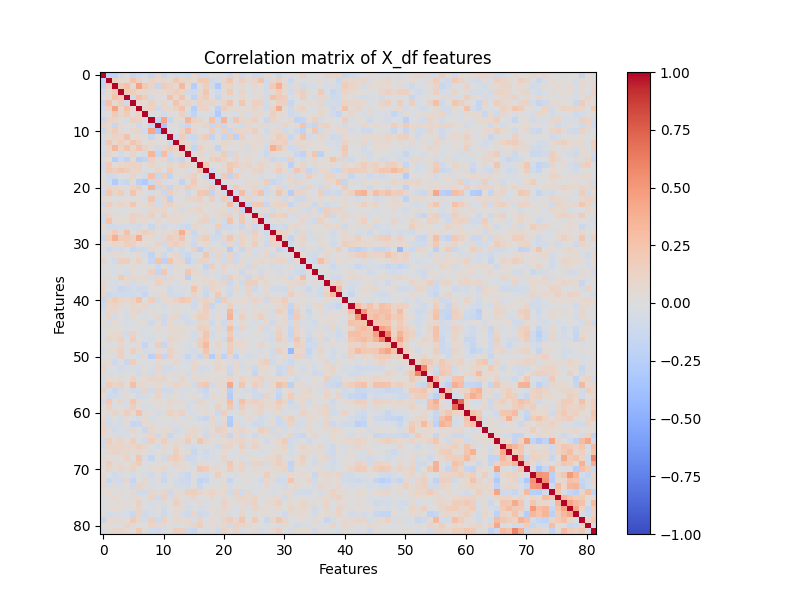

In [73]:
correlation_matrix(X_df)

From this correlation matrix we can see that most of our data are barely on not correlated at all except for some data among 40 and 50 rows and columns which represent phobias and other couple of features.

## Exercise 2. Analyzing the Variance and the PCs

In the cells below, do the following operations:
1. create two new dataframes from _X_df_ applying a StandardScaler and a MinMaxscaler. Call these new dataframes as _Xstd_df_ and _Xmm_df_, respectively;
2. compute the variance of all the features in _X_df_, _Xstd_df_, and _Xmm_df_ and **comment the results**;
3. compute all the $n$ Principal Components (PCs) for each dataset _X_df_, _Xstd_df_, and _Xmm_df_. Then, visualize the curves of the cumulative explained variances and **comment the results**.

### Exercise 2.1 Create Xstd_df and Xmm_df

In [74]:
std = StandardScaler()
mm = MinMaxScaler()
Xstd_df = pd.DataFrame(std.fit_transform(X_df), columns=X_df.columns)
Xmm_df = pd.DataFrame(mm.fit_transform(X_df), columns=X_df.columns)

### Exercise 2.2 Compute the variance
The original dataframe has all values are included between 1.0 and 5.0 and so here the variance will not be too high but it changes from a minimum of 0.254 to a maximum of 2.383. Columns with higher variance could influence more PCA or other models than columns with lower variance.  
The variance of all the columns of Xstd_df is fixed to 1 because it is a standardized dataset and so data are normalized to obtain 0 as mean and 1 as variance thanks to this formula:
$$
z = \frac{x - \mu}{\sigma}
$$
where $ z $ is the normalized value, $ x $ is the original value, $ \mu $ is the mean of the dataset and $ \sigma $ is the standard deviation of the dataset.   
In Xmm_df case we have all values between 0 and 1. This scaler mantain all the proportions among data of the original dataframe. In fact, the columns with higher and lower variance correspond to the same features of the original dataframes.

In [75]:
var_df = pd.concat((X_df.var(), Xstd_df.var(), Xmm_df.var()), axis=1)
var_df.columns = ["X","X_std","X_mm"]
var_df

,X,X_std,X_mm
Internet usage,0.254504,1.002232,0.063626
Giving,1.649280,1.002232,0.103080
Prioritising workload,1.497087,1.002232,0.093568
Parents' advice,0.657244,1.002232,0.041078
Thinking ahead,1.236160,1.002232,0.077260
...,...,...,...
Rock n roll,1.497216,1.002232,0.093576
Alternative,1.747504,1.002232,0.109219
Latino,1.674207,1.002232,0.104638
"Techno, Trance",1.706530,1.002232,0.106658


### Exercise 2.3 Compute the PCA of the 3 datasets and visualize the curves of cumulative explained ratio

In [76]:
def display_total_variance_ratio(X,title):
    pca = PCA()
    pca.fit(X.values)

    plt.figure(figsize=(8,6))
    plt.plot(np.cumsum(pca.explained_variance_ratio_))
    plt.title(f"Cumulative explained variance of {title}")
    plt.xlabel('Principal components')
    plt.ylabel('Cumulative explained variance')
    plt.ylim(0, 1.1)
    plt.grid()
        
    plt.tight_layout()
    
    return pca

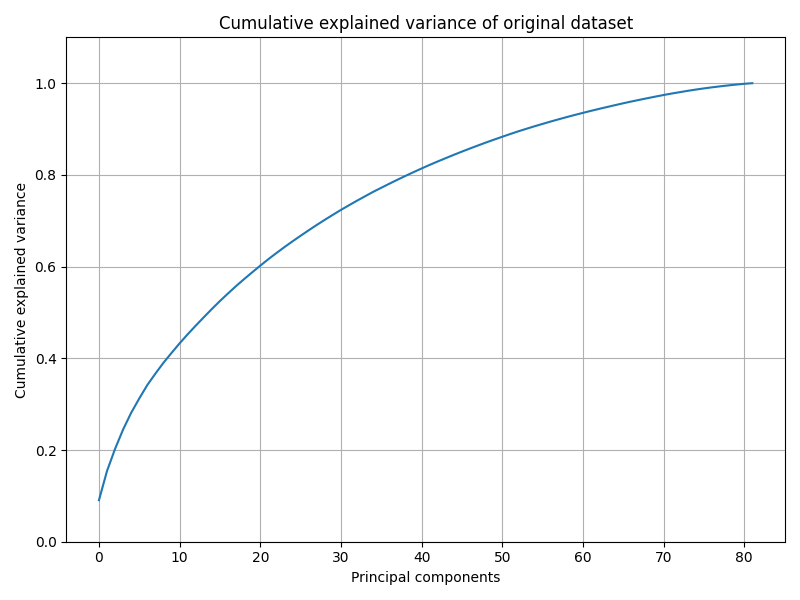

In [77]:
pca = display_total_variance_ratio(X_df,"original dataset")

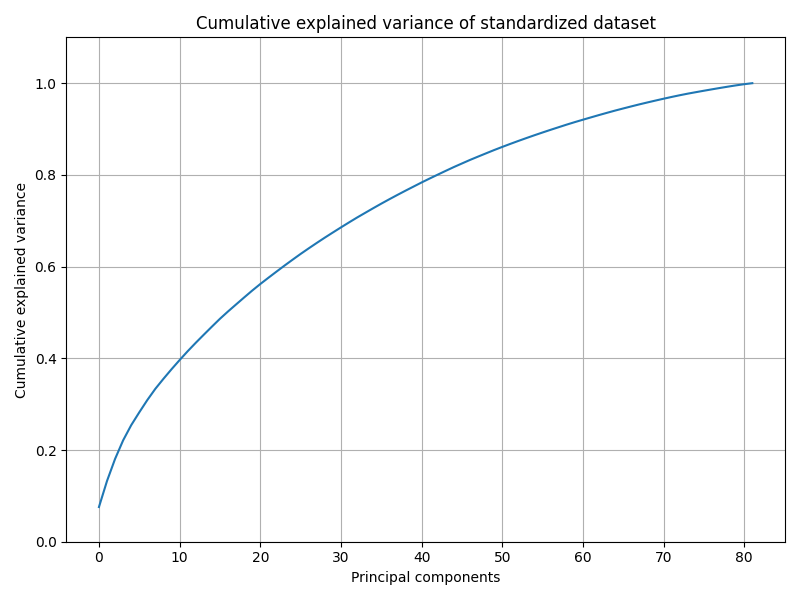

In [78]:
pca_std = display_total_variance_ratio(Xstd_df,"standardized dataset")

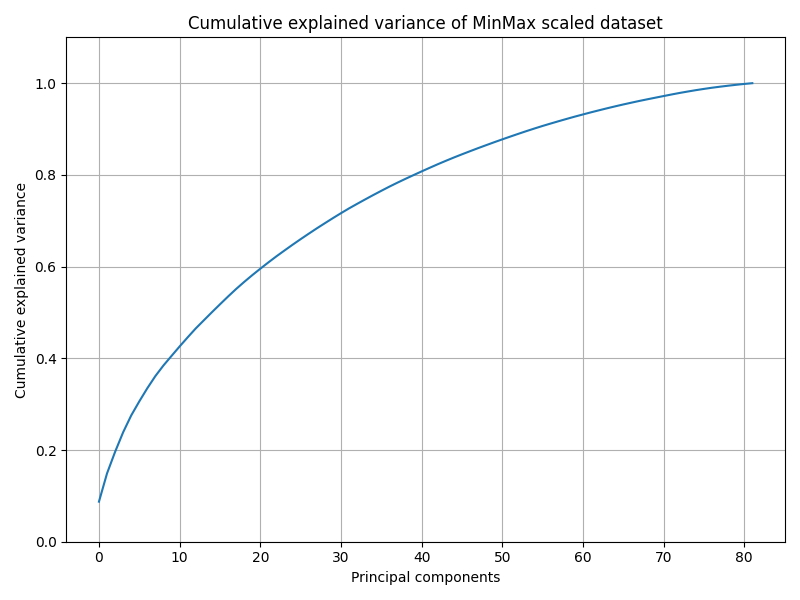

In [79]:
pca_mm = display_total_variance_ratio(Xmm_df,"MinMax scaled dataset")

The cumulative explained variance represents the total amount of variance in the original data that is explained by the selected principal components. As we can see from these images, there are 82 principal components and only the first 10 represent more than the 40% of the total variance in the original data. The curves plotted here show us that each single PC does not explain too much variance since we need 60 of 82 PCs to obtain the 90% of it. 

## Exercise 3. Dimensionality Reduction and PC Interpretation

In the cells below, do the following operations:
1. For each one of the two dataframes _Xstd_df_, and _Xmm_df_, compute a new PCA for performing a dimensionality reduction with respect to $m$ dimensions. The value of $m$ must be $$m = \min\{m', 5\}\,,$$ where $m'$ is the value required for obtaining $33\%$ of the total variance.
2. For both the cases, visualize all the PCs and give a name/interpretation to them. **Comment and motivate your interpretations**. If possible, **compare the differences among the results obtained** for _Xstd_df_ and _Xmm_df_.
3. Perform the score graph for both the cases (_std_ and _mm_). If $m>3$, plot the score graph with respect to the first 3 PCs. All the **plots must show the names of the PCs on the axes** for better understanding the results.
4. **Optional:** plot more score graphs, coloring the dots with respect to any label in the list _labels_ that you believe can be interesting. **Comment and analyze this optional plots**.

### Exercise 3.1 Compute PCA with respect to m dimensions

In [80]:
threshold = 0.33
num_components_std = np.argmax(np.cumsum(pca_std.explained_variance_ratio_) >= threshold)+1
print(num_components_std)

8


In [81]:
num_components_mm= np.argmax(np.cumsum(pca_mm.explained_variance_ratio_) >= threshold)+1
print(num_components_mm)

7


From the two cells above we can see that to reach more than the 33% of total explained variance we need 8 and 7 components, respectively. So we will use $$ m = 5 $$ for both the dataframes.

### Exercise 3.2 give a name to each Principal Component

In [82]:
def compute_pca(X, m, title):
    pca = PCA(n_components=m)
    pca.fit(X)  
    round_expl_var_ratio = np.round(pca.explained_variance_ratio_.sum()*100,decimals=2)

    plt.figure()
    plt.bar(range(1,m+1), pca.explained_variance_ratio_)
    plt.title(f"{round_expl_var_ratio}% of total explained variance of {title}")
    plt.xticks(ticks=np.arange(1,m+1), 
            labels=[f"PC{i}" for i in range(1,m+1)])
    plt.xlabel("Principal Components")
    plt.ylabel("Percentage of Explained variance")
    plt.show()
    return pca

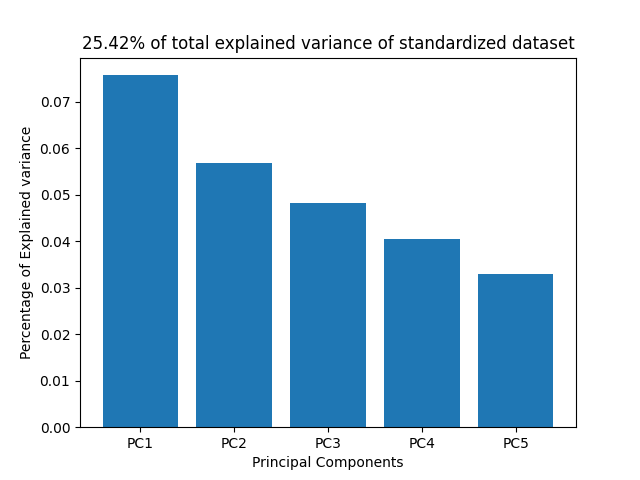

In [83]:
m_std = min(5,num_components_std)
pca_std = compute_pca(Xstd_df, m_std, "standardized dataset")

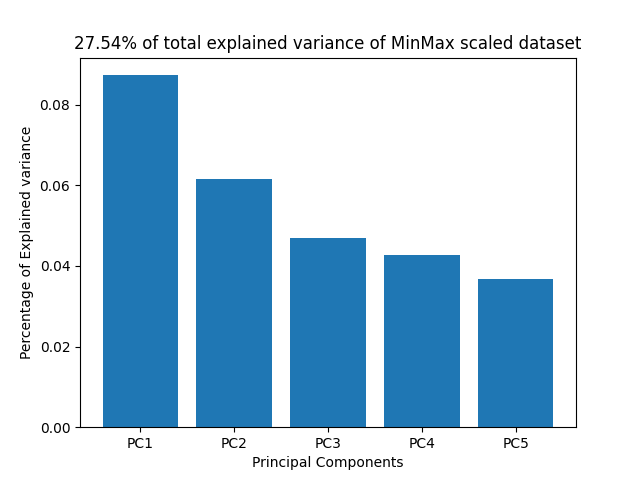

In [84]:
m_mm = min(5,num_components_mm)
pca_mm = compute_pca(Xmm_df, m_mm, "MinMax scaled dataset")

As we have seen in theory, the min-max scaled dataframe shows a slightly better percentage of total explained variance, as this type of scaling is more suitable than standardization when all features are categorical and represented by rank values (ranging from 1 to 5), as in this case.

In [85]:
set3 = cm.Set3.colors

type_colors = {
    'Health': set3[2],
    'Movies': set3[3],
    'Music': set3[4],
    'Personality': set3[5],
    'Phobias': set3[6]
}

In [86]:
def setColor(labels):
    colors=[]
    for l in labels:
        for key,val in variables_by_type.items():
            if l in val:
                colors.append(type_colors[key])
    return colors

In [87]:
def plot_single_PCs(X, pca, m, title):
    eps = np.sqrt(1 / pca.n_features_in_)

    cols = X.columns.to_list()

    for ii in range(m):
        ind_great_pos_PCii = np.where(pca.components_[ii, :] >= eps)[0]
        ind_great_neg_PCii = np.where(pca.components_[ii, :] <= -eps)[0]

        type_colors_legend = [Line2D([0], [0], color=type_colors[k]) for k in type_colors.keys()]
        
        plt.figure(figsize=(9, 6)) 
        plt.bar(np.arange(pca.n_features_in_), pca.components_[ii,:], color=setColor(pca.feature_names_in_))
        plt.plot([-0.5, len(cols) - 0.5], [eps, eps], "red", linestyle="--", label=r"$\epsilon$")
        plt.plot([-0.5, len(cols) - 0.5], [-eps, -eps], "red", linestyle="--")
        plt.xlabel("Features")
        plt.ylabel("Importance")
        plt.title(f"Features of {title} (Colored by category) - PC{ii + 1}")
        plt.grid()
        plt.tight_layout()
        plt.legend(type_colors_legend, [k for k in type_colors.keys()])
        plt.show()
        
        great_pos_PCii= [pca.feature_names_in_[i] for i in ind_great_pos_PCii]    
        great_neg_PCii= [pca.feature_names_in_[i] for i in ind_great_neg_PCii]
        
        print(f'PC{ii+1}:')
        print(f'HIGH-VALUED POSITIVE COMPONENTS: {great_pos_PCii}')
        print(f'HIGH-VALUED NEGATIVE COMPONENTS: {great_neg_PCii}')

The following plots are are the projections of the features in the first 5 principal components.   
Each feature is colored based on the category it belongs to.

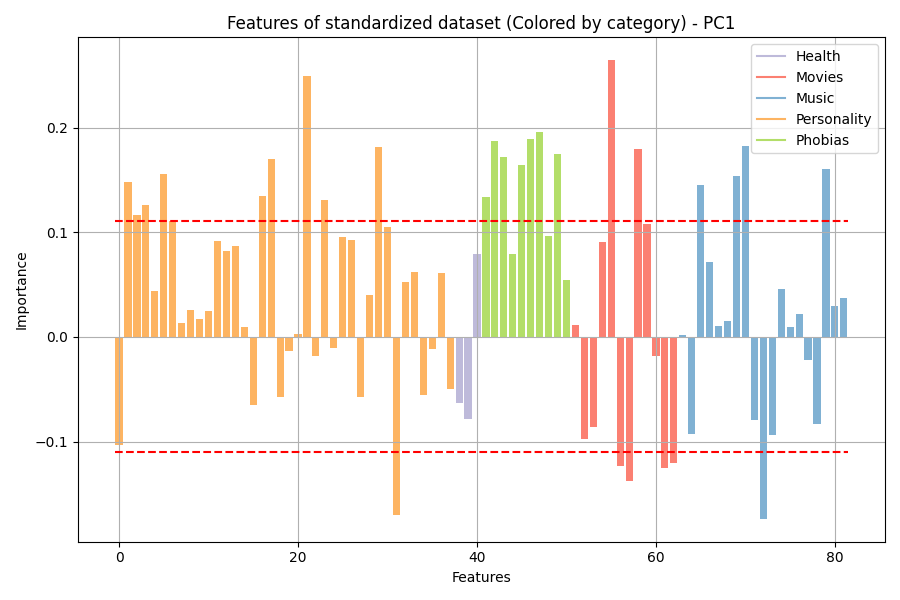

PC1:
HIGH-VALUED POSITIVE COMPONENTS: ['Giving', 'Prioritising workload', "Parents' advice", 'Children', 'Workaholism', 'Appearence and gestures', 'Health', 'Life struggles', 'Empathy', 'Writing notes', 'Flying', 'Storm', 'Darkness', 'Spiders', 'Snakes', 'Rats', 'Dangerous dogs', 'Romantic', 'Fantasy/Fairy tales', 'Dance', 'Musical', 'Pop', 'Latino']
HIGH-VALUED NEGATIVE COMPONENTS: ['Small - big dogs', 'Sci-fi', 'War', 'Western', 'Action', 'Metal or Hardrock']


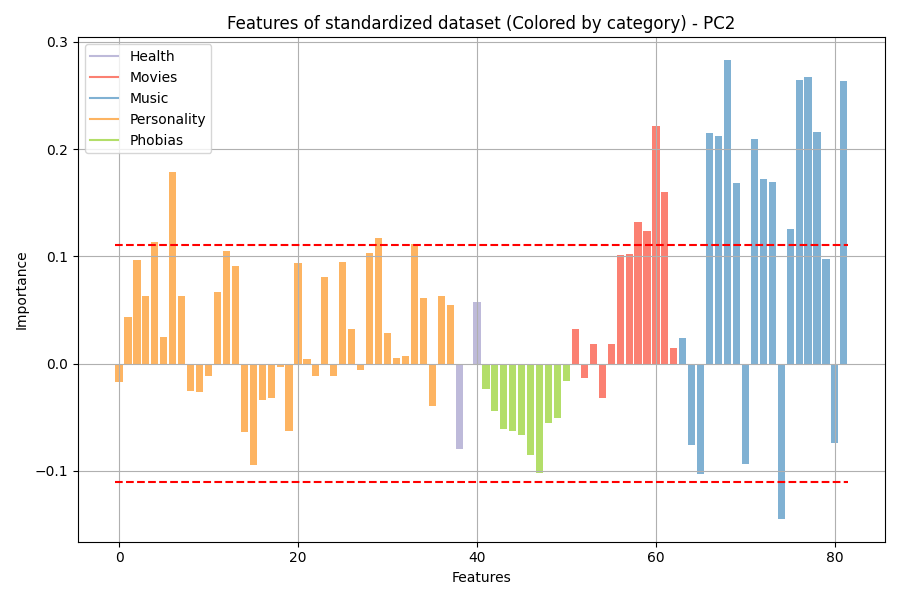

PC2:
HIGH-VALUED POSITIVE COMPONENTS: ['Thinking ahead', 'Workaholism', 'Writing notes', 'Self-criticism', 'Fantasy/Fairy tales', 'Animated', 'Documentary', 'Western', 'Folk', 'Country', 'Classical music', 'Musical', 'Rock', 'Metal or Hardrock', 'Punk', 'Reggae, Ska', 'Swing, Jazz', 'Rock n roll', 'Alternative', 'Opera']
HIGH-VALUED NEGATIVE COMPONENTS: ['Hiphop, Rap']


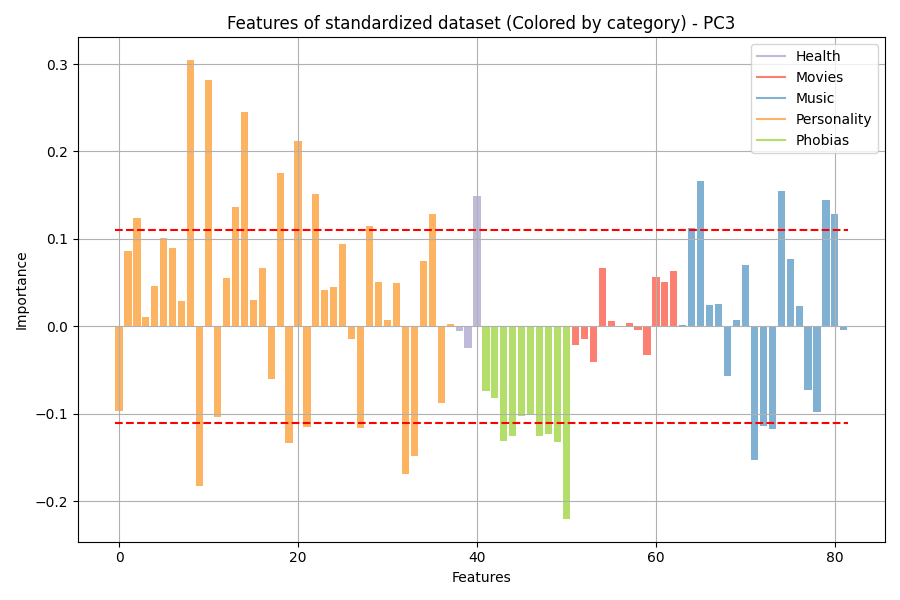

PC3:
HIGH-VALUED POSITIVE COMPONENTS: ['Prioritising workload', 'Energy levels', 'Happiness in life', 'Reliability', 'Personality', 'New environment', 'Interests or hobbies', 'Assertiveness', 'Keeping promises', 'Dreams', 'Healthy eating', 'Slow songs or fast songs', 'Dance', 'Hiphop, Rap', 'Latino', 'Techno, Trance']
HIGH-VALUED NEGATIVE COMPONENTS: ['Changing the past', 'Getting up', 'Life struggles', 'Lying', 'Hypochondria', 'Self-criticism', 'Darkness', 'Heights', 'Rats', 'Ageing', 'Dangerous dogs', 'Fear of public speaking', 'Rock', 'Metal or Hardrock', 'Punk']


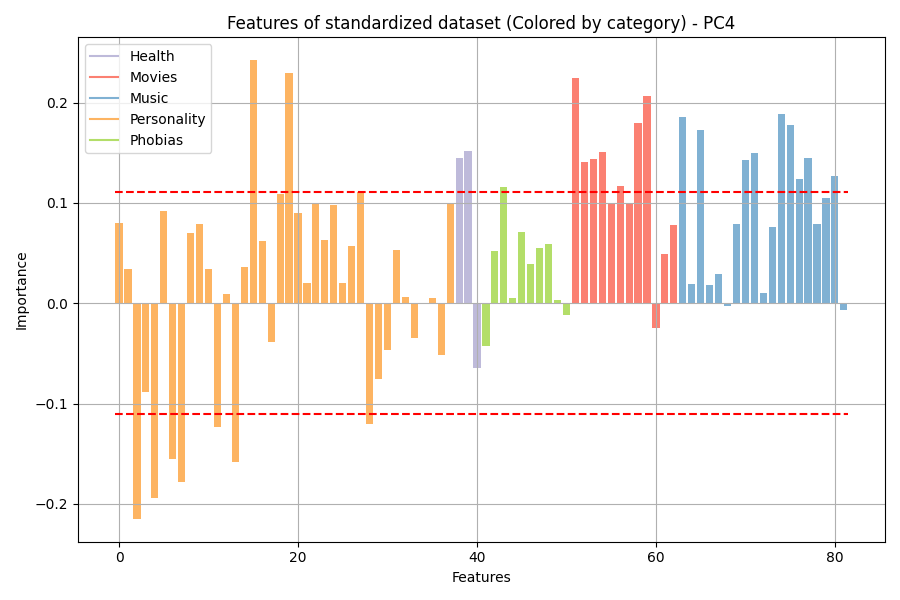

PC4:
HIGH-VALUED POSITIVE COMPONENTS: ['Cheating in school', 'Getting up', 'Lying', 'Smoking', 'Alcohol', 'Darkness', 'Movies', 'Horror', 'Thriller', 'Comedy', 'Sci-fi', 'Fantasy/Fairy tales', 'Animated', 'Music', 'Dance', 'Pop', 'Rock', 'Hiphop, Rap', 'Reggae, Ska', 'Swing, Jazz', 'Rock n roll', 'Techno, Trance']
HIGH-VALUED NEGATIVE COMPONENTS: ['Prioritising workload', 'Thinking ahead', 'Workaholism', 'Punctuality', 'Decision making', 'Reliability', 'Keeping promises']


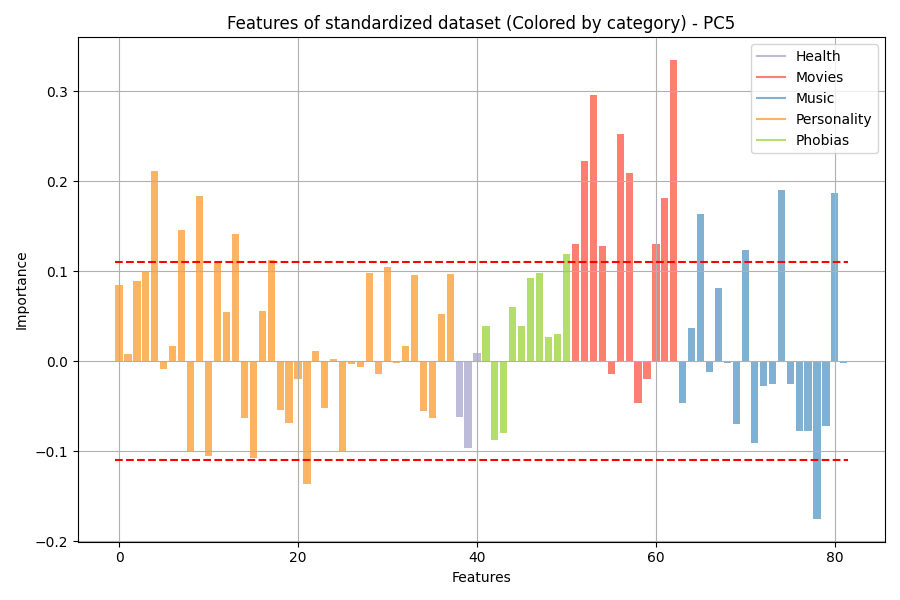

PC5:
HIGH-VALUED POSITIVE COMPONENTS: ['Thinking ahead', 'Punctuality', 'Changing the past', 'Decision making', 'Reliability', 'Health', 'Fear of public speaking', 'Movies', 'Horror', 'Thriller', 'Comedy', 'Sci-fi', 'War', 'Documentary', 'Western', 'Action', 'Dance', 'Pop', 'Hiphop, Rap', 'Techno, Trance']
HIGH-VALUED NEGATIVE COMPONENTS: ['Life struggles', 'Alternative']


In [88]:
plot_single_PCs(Xstd_df, pca_std, m_std, "standardized dataset")

The high valued components are those features whose importance is higher than a threshold $$\epsilon = \sqrt{1/n}$$ ($n$ is the number of features).

In [89]:
pc_names_std = ["Empathy & sensitive (+) vs Action oriented (-)", 
            "Music tastes", 
            "Optimistic (+) vs Pessimistic (-)",
            "Bad habits (+) vs Good habits (-)",
            "Cinematic tastes"
            ]

Given the high valued positive and negative components of each principal component we decide to give these names:
1. PC1 - Empathy & Creative (+) vs Action oriented (-): in the positive side the most important features are related to the personality and music that gives us the profile of an empathetic and creative person, but we have also many phobias typical of a sensitive person. On the other hand, in the negative side War, Western and Action movies mixed with Metal and Hardrock music gives us the idea of an action oriented person
2. PC2 - Music tastes: The second principal component is represented by high values in most of music features creating a profile based on these features. the high valued negative component is only hip hop, Rap which could represent a person who loves music of modern genres
3. PC3 - Optimistic (+) vs Pessimistic (-): most of the high valued components of this PC come from personality features and on the positive side we find optimistic people which are also happy and full of energy while in the negative side we find pessimistic people based on their personality but also on their dark music tastes
4. PC4 - Bad habits (+) vs Good habits (-): all high valued positive components of this PC come from personality features and describe a person with bad habits such as lying, smoking and alcohol while on the other side we have all good habits related to work that describe a diligent person
5. PC5 - Cinematic tastes: All the most high valued components of this PC are related to Movies features and so this one describe people based on cinematic tastes

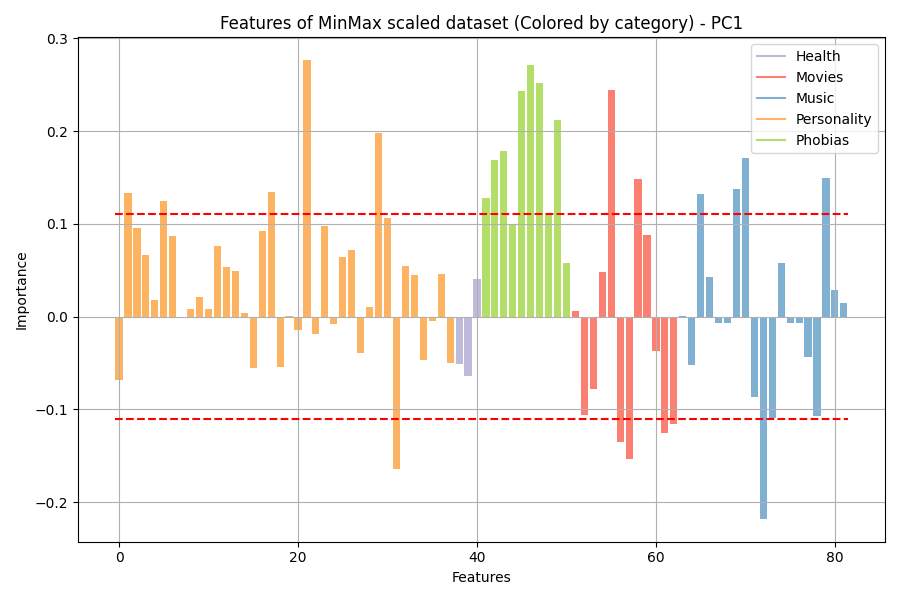

PC1:
HIGH-VALUED POSITIVE COMPONENTS: ['Giving', 'Children', 'Health', 'Life struggles', 'Writing notes', 'Flying', 'Storm', 'Darkness', 'Spiders', 'Snakes', 'Rats', 'Ageing', 'Dangerous dogs', 'Romantic', 'Fantasy/Fairy tales', 'Dance', 'Musical', 'Pop', 'Latino']
HIGH-VALUED NEGATIVE COMPONENTS: ['Small - big dogs', 'Sci-fi', 'War', 'Western', 'Action', 'Metal or Hardrock']


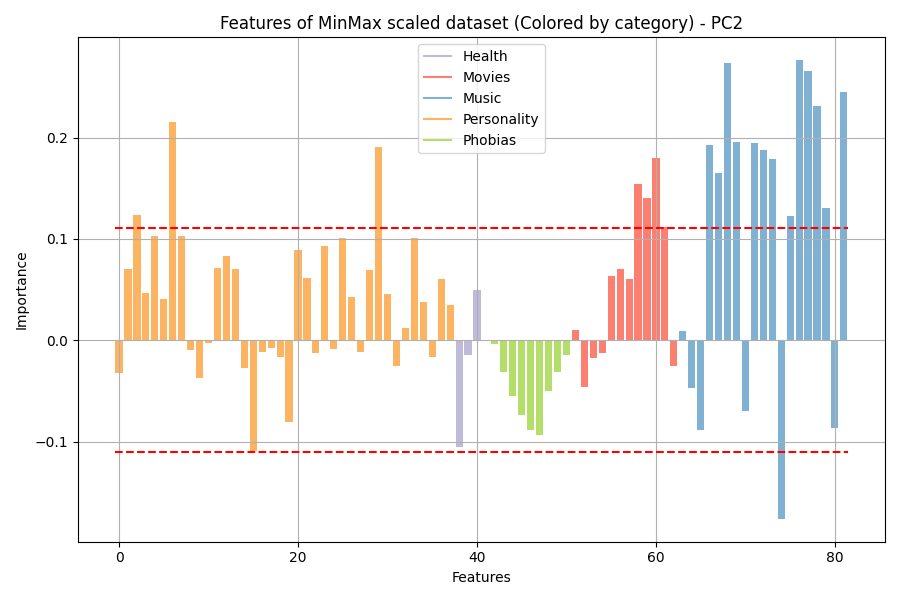

PC2:
HIGH-VALUED POSITIVE COMPONENTS: ['Prioritising workload', 'Workaholism', 'Writing notes', 'Fantasy/Fairy tales', 'Animated', 'Documentary', 'Western', 'Folk', 'Country', 'Classical music', 'Musical', 'Rock', 'Metal or Hardrock', 'Punk', 'Reggae, Ska', 'Swing, Jazz', 'Rock n roll', 'Alternative', 'Latino', 'Opera']
HIGH-VALUED NEGATIVE COMPONENTS: ['Hiphop, Rap']


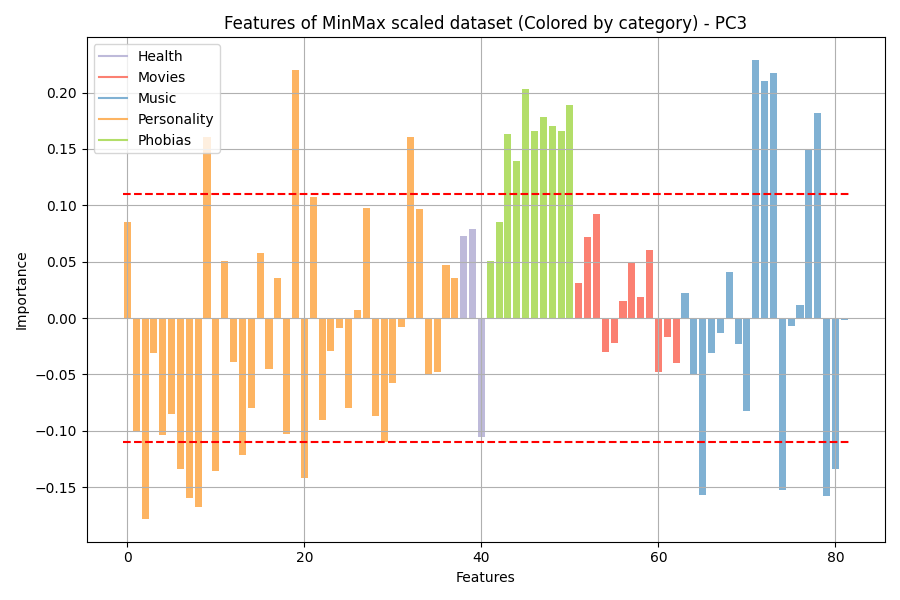

PC3:
HIGH-VALUED POSITIVE COMPONENTS: ['Changing the past', 'Getting up', 'Hypochondria', 'Darkness', 'Heights', 'Spiders', 'Snakes', 'Rats', 'Ageing', 'Dangerous dogs', 'Fear of public speaking', 'Rock', 'Metal or Hardrock', 'Punk', 'Rock n roll', 'Alternative']
HIGH-VALUED NEGATIVE COMPONENTS: ['Prioritising workload', 'Workaholism', 'Punctuality', 'Energy levels', 'Happiness in life', 'Reliability', 'Interests or hobbies', 'Dance', 'Hiphop, Rap', 'Latino', 'Techno, Trance']


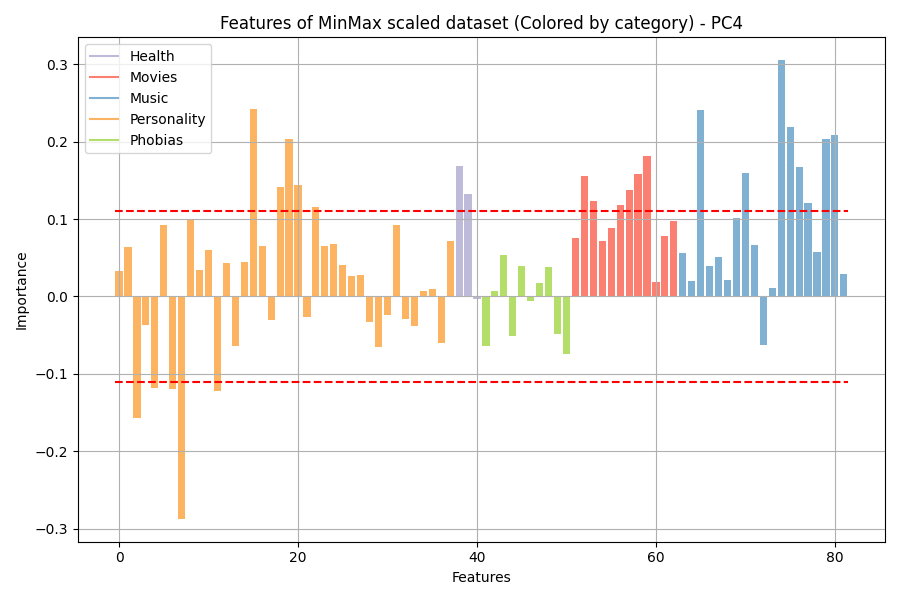

PC4:
HIGH-VALUED POSITIVE COMPONENTS: ['Cheating in school', 'New environment', 'Getting up', 'Interests or hobbies', 'Assertiveness', 'Smoking', 'Alcohol', 'Horror', 'Thriller', 'Sci-fi', 'War', 'Fantasy/Fairy tales', 'Animated', 'Dance', 'Pop', 'Hiphop, Rap', 'Reggae, Ska', 'Swing, Jazz', 'Rock n roll', 'Latino', 'Techno, Trance']
HIGH-VALUED NEGATIVE COMPONENTS: ['Prioritising workload', 'Thinking ahead', 'Workaholism', 'Punctuality', 'Decision making']


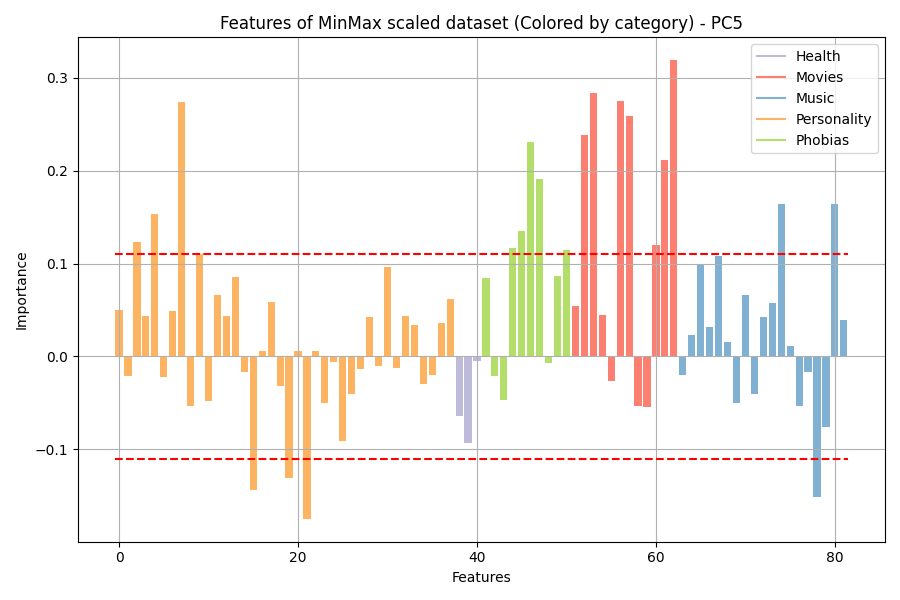

PC5:
HIGH-VALUED POSITIVE COMPONENTS: ['Prioritising workload', 'Thinking ahead', 'Punctuality', 'Heights', 'Spiders', 'Snakes', 'Rats', 'Fear of public speaking', 'Horror', 'Thriller', 'Sci-fi', 'War', 'Documentary', 'Western', 'Action', 'Hiphop, Rap', 'Techno, Trance']
HIGH-VALUED NEGATIVE COMPONENTS: ['Cheating in school', 'Getting up', 'Life struggles', 'Alternative']


In [90]:
plot_single_PCs(Xmm_df, pca_mm, m_mm, "MinMax scaled dataset")

In [91]:
pc_names_mm = ["Phobias", 
            "Music tastes", 
            "Phobias (+) vs Optimistic (-)",
            "Irresponsible (+) vs Diligent (-)",
            "Cinematic tastes"
            ]

Given the high valued positive and negative components of each principal component we decide to give these names:
1. PC1 - Phobias: the most high valued components of this PC are related to the phobias of a person
2. PC2 - Music tastes: The second principal component is represented by high values in most of music features creating a profile based on these features. the high valued negative component is only hip hop, Rap which could represent a person who loves music of modern genres
3. PC3 - Phobias (+) vs Optimistic (-): most of the high valued positive components of this PC come from phobias features while in the negative side we find optimistic people full of energy and happiness based on their personality
4. PC4 - Irresponsible (+) vs Diligent (-): all high valued positive components of this PC describe an irresponsible person with bad habits such as cheating in school, smoking and alcohol who watch movies like war, horror and thriller while on the other side we have all good habits related to work that describe a diligent person
5. PC5 - Cinematic tastes: All the most high valued components of this PC are related to Movies features and so this one describe people based on cinematic tastes

Most of the 5 PCs of the two dataset are likely the same but we have some differences such as higher values in phobias features for PC1 in Xmm_df than in Xstd_fd and also in PC3 phobias are negative components in Xstd_df and positive in Xmm_df

### Exercise 3.3 Plot score graphs

In [92]:
def plot_score_graph(X, pca, features, pc_names):
    Y = pca.transform(X)
    
    for feat in features: 
        fig = plt.figure(figsize=(12, 6))
        fig.suptitle(f"{feat} - Score Graph", fontsize=16)

        ax_3d = fig.add_subplot(1, 2, 1, projection='3d')
        ax_3d.scatter(Y[:, 0], Y[:, 1], Y[:, 2], s=10, alpha=1, c=X[feat].values)
        ax_3d.set_xlabel(pc_names[0])
        ax_3d.set_ylabel(pc_names[1])
        ax_3d.set_zlabel(pc_names[2])
        ax_3d.grid()

        ax_2d = fig.add_subplot(1, 2, 2)
        score_graph = ax_2d.scatter(Y[:, 0], Y[:, 1], s=10, alpha=1, c=X[feat].values)
        plt.colorbar(score_graph, ax=ax_2d)
        ax_2d.set_xlabel(pc_names[0])
        ax_2d.set_ylabel(pc_names[1])
        ax_2d.grid()

        plt.tight_layout()
        plt.show()
    return Y


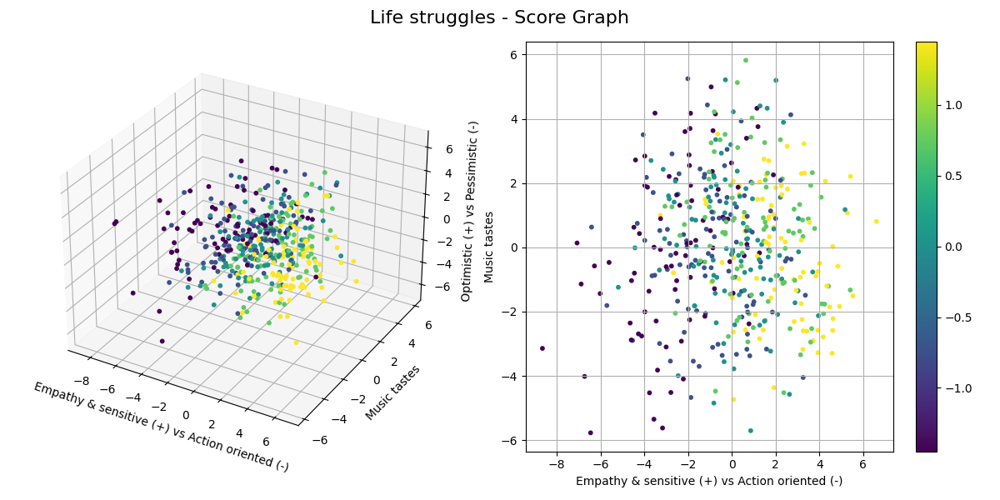

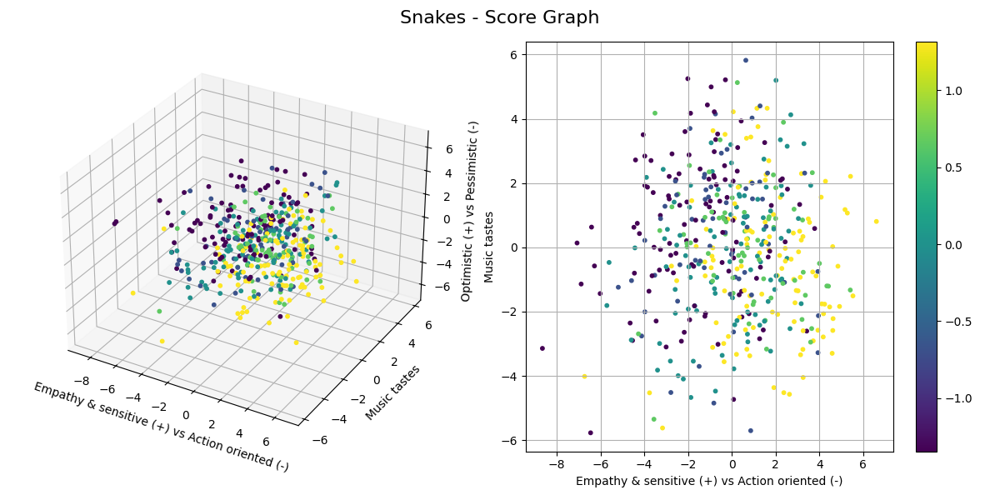

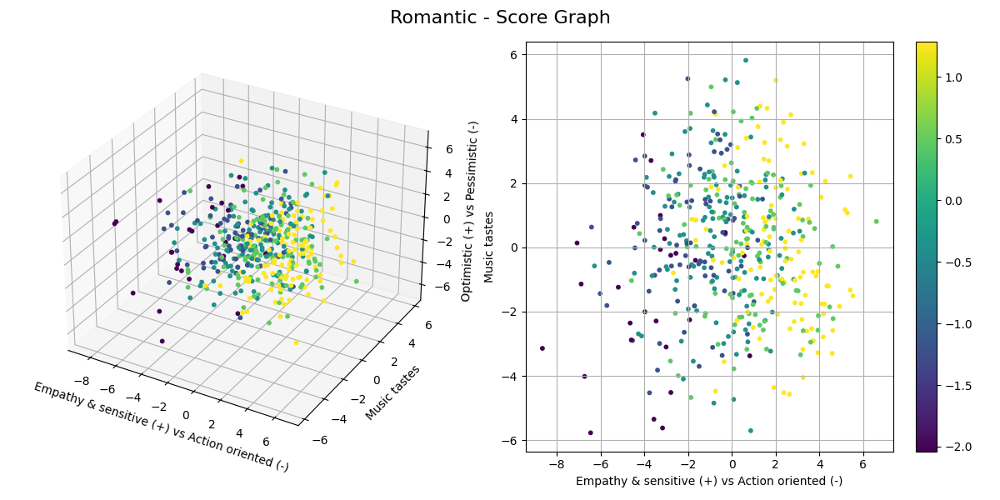

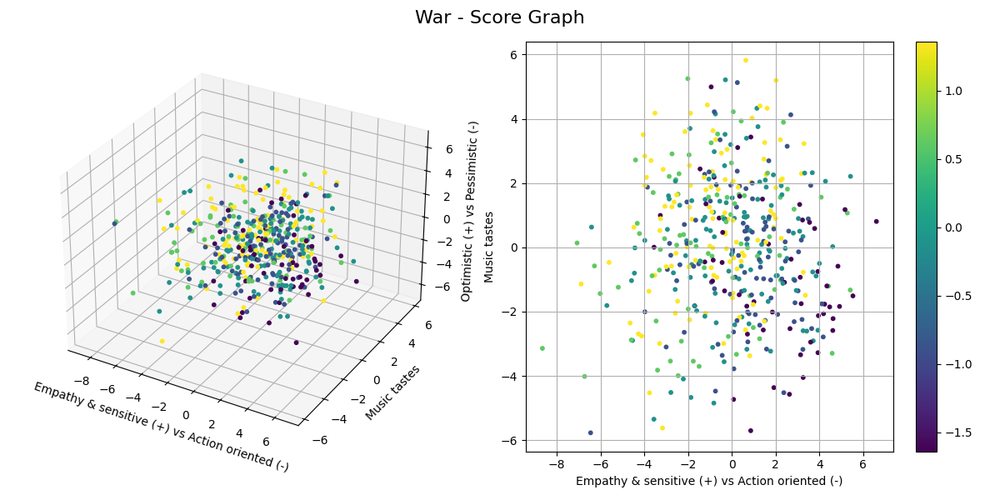

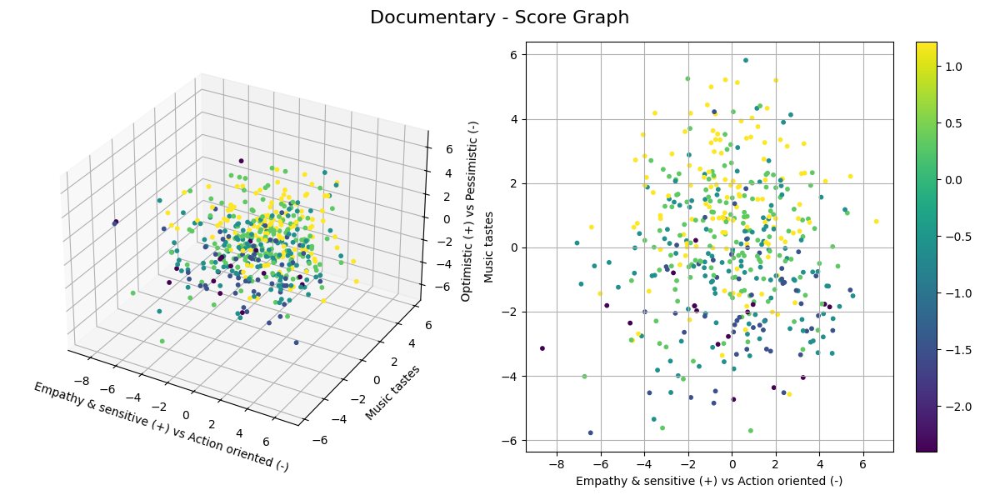

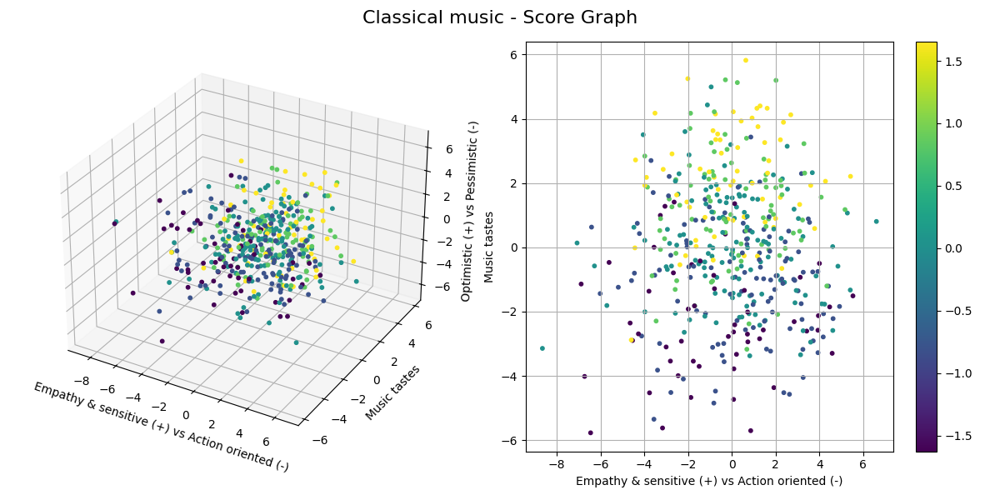

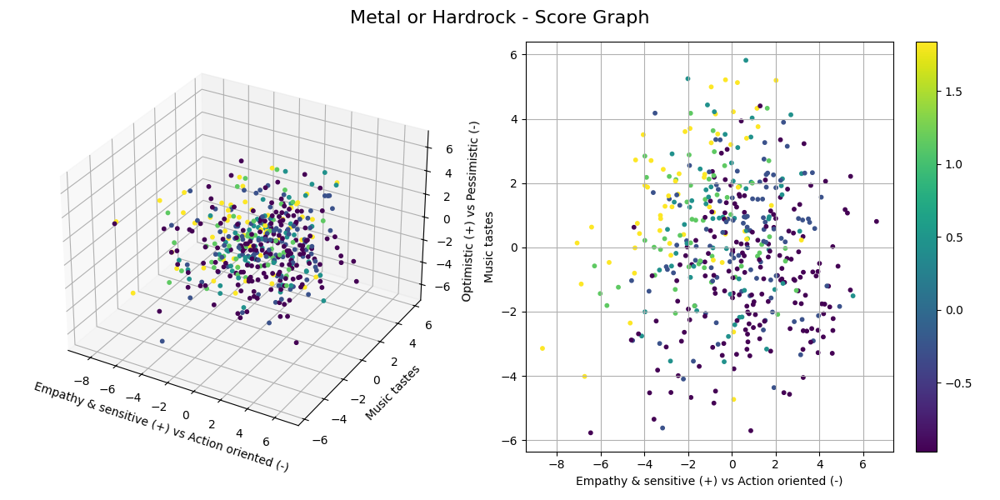

In [93]:
Ystd_df = plot_score_graph(Xstd_df, pca_std, ['Life struggles', 'Snakes', 'Romantic', 
            'War', 'Documentary', 'Classical music', 'Metal or Hardrock'], pc_names_std)

We decide to plot the 3D graph with respect to the first three PCs and the 2D projection with respect to PC1 and PC2. We want to emphasize how PC1 and PC2 represent some features with respect to the colors of the points based on the values of those features:
1. The features Life struggles, Snakes and Romantic show how low values are in the left side of the 2D plot while high values are in the right side and so they represent an Empathetic and sensitive person
2. War is the opposite situation: low values are on the right side while high values are on the left side so it represents action oriented people
3. Classical music and documentary are more described by PC2, in fact, low values are on the bottom while high values are at the top. Thanks to this representation we have found an interesting feature (Documentary) which is explained by a principal component focused on musical tastes so we can add information to the profile of a person described by PC2
4. Metal or Hardrock has low values at the bottom right corner and higher values at the top left corner meaning that both PCs describe this feature

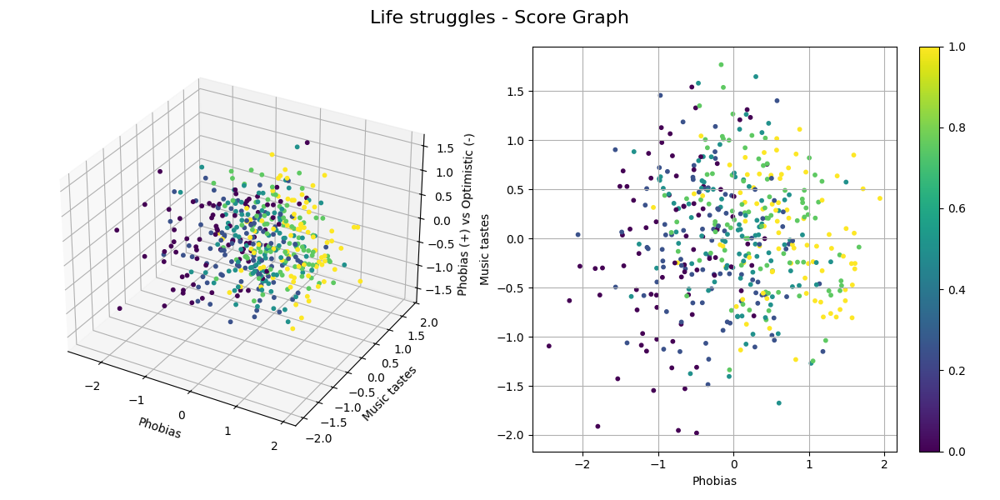

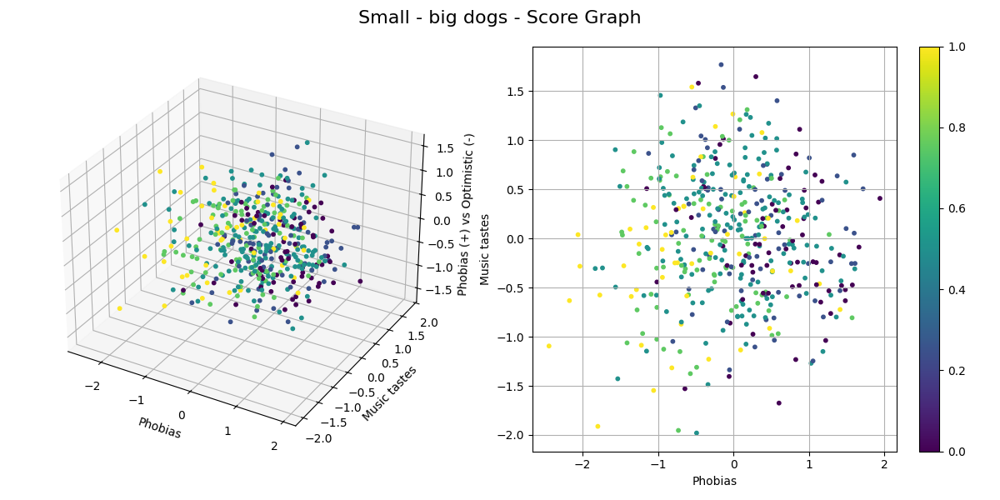

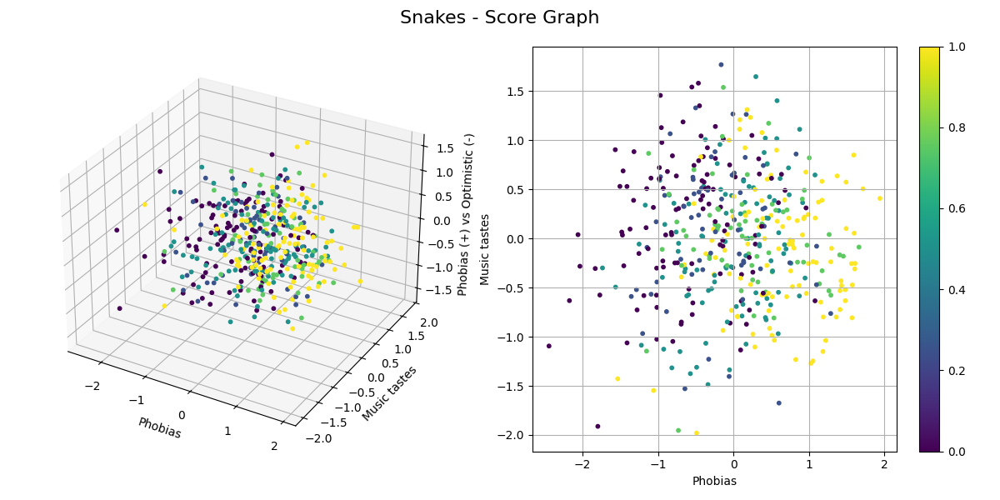

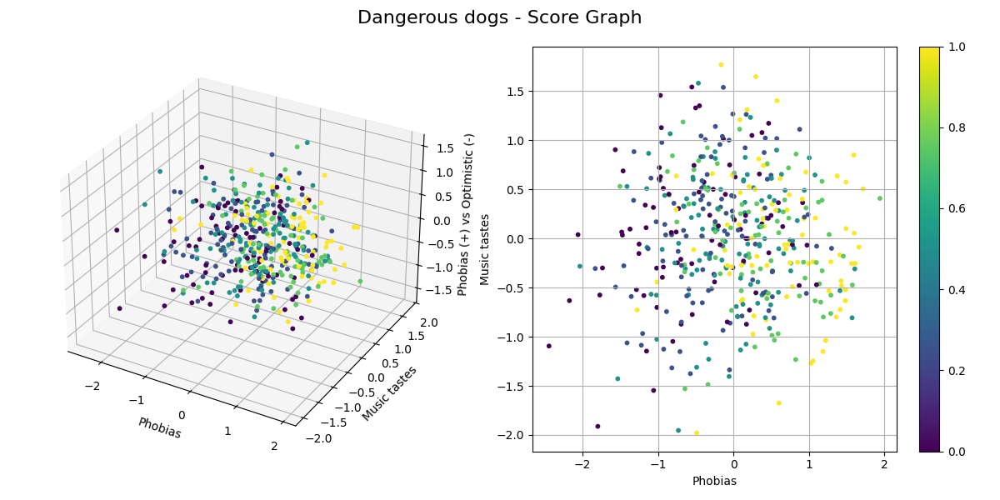

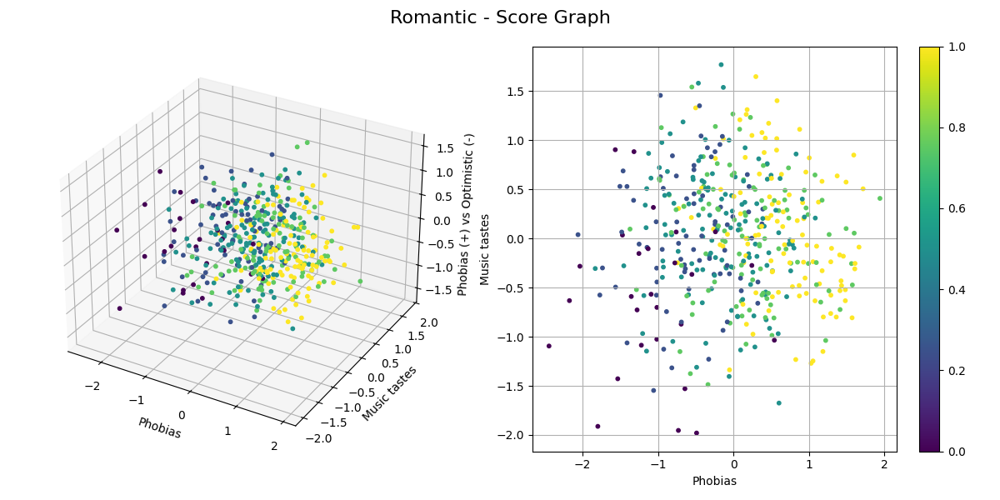

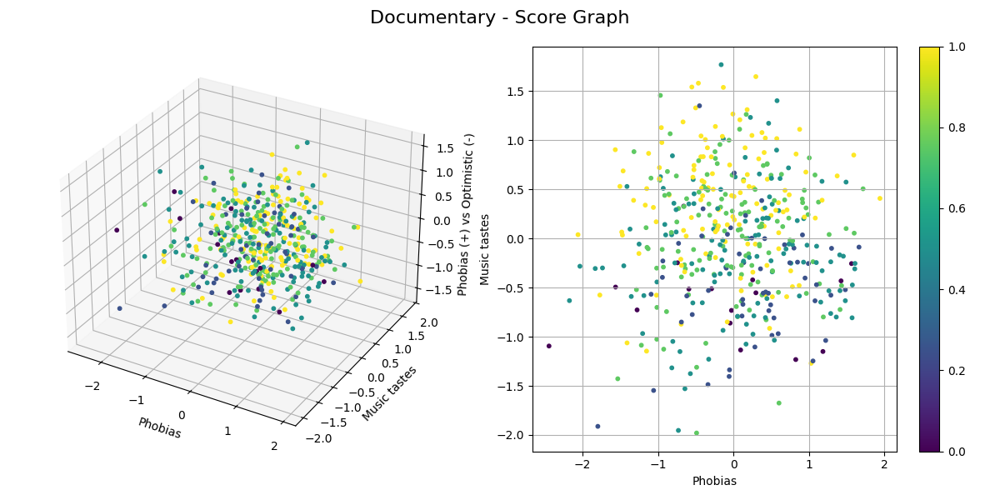

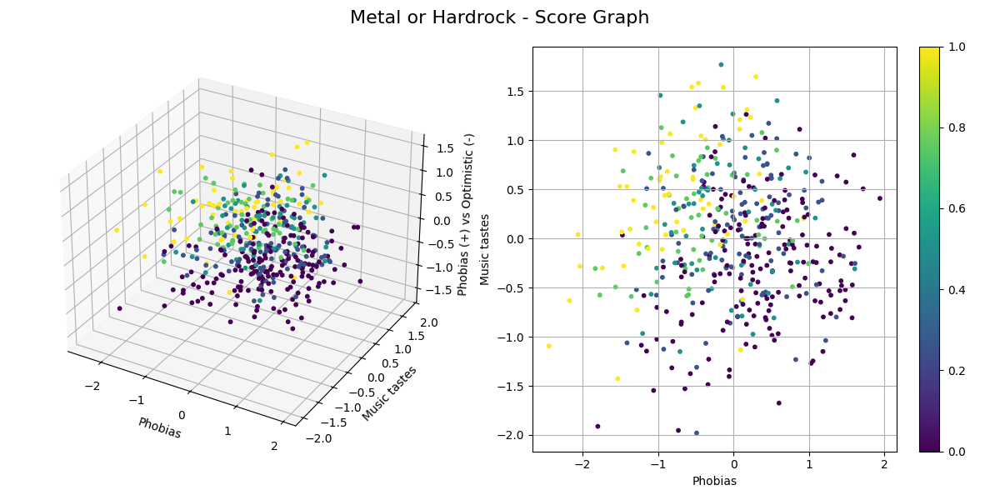

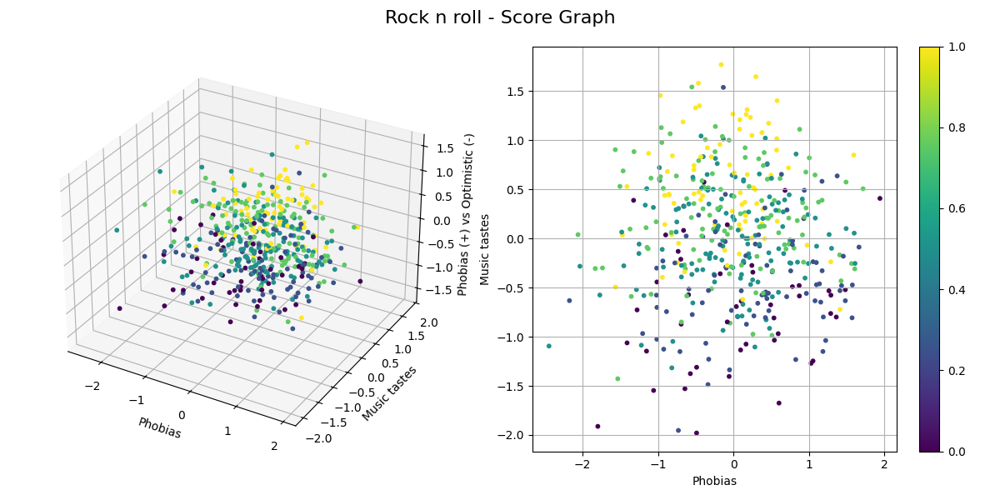

In [94]:
Ymm_df = plot_score_graph(Xmm_df, pca_mm, ["Life struggles", "Small - big dogs", "Snakes",
                                           "Dangerous dogs", "Romantic", "Documentary", "Metal or Hardrock", "Rock n roll"], pc_names_mm)

We decide to plot the 3D graph with respect to the first three PCs and the 2D projection with respect to PC1 and PC2. We want to emphasize how PC1 and PC2 represent some features with respect to the colors of the points based on the values of those features:
1. The features Life struggles, Snakes, Dangerous dogs and Romantic show how low values are in the left side of the 2D plot while high values are in the right side and so they are well described by PC1 which is related to phobias
2. Small - big dogs is the opposite situation: low values are on the right side while high values are on the left side so it says that people who are not scared of dangerous dogs usually like small or big dogs
3. Rock n roll and documentary are more described by PC2, in fact, low values are on the bottom while high values are at the top. Thanks to this representation we have found an interesting feature (Documentary) which is explained by a principal component focused on musical tastes so we can add information to the profile of a person described by PC2
4. Metal or Hardrock has low values at the bottom right corner and higher values at the top left corner meaning that both PCs describe this feature

### Exercise 3.4 Plot score graph with respect to demographic features

In [95]:
def plot_score_graph_labels(Y, features, pc_names, title):
    for feat in features: 
        fig = plt.figure(figsize=(12, 6))
        fig.suptitle(f"{feat} - Score Graph of the {title}", fontsize=16)

        ax_3d = fig.add_subplot(1, 2, 1, projection='3d')
        ax_3d.scatter(Y[:, 0], Y[:, 1], Y[:, 2], s=10, alpha=1, c=demographics[feat].values)
        ax_3d.set_xlabel(pc_names[0])
        ax_3d.set_ylabel(pc_names[1])
        ax_3d.set_zlabel(pc_names[2])
        ax_3d.grid()

        ax_2d = fig.add_subplot(1, 2, 2)
        score_graph = ax_2d.scatter(Y[:, 0], Y[:, 1], s=10, alpha=1, c=demographics[feat].values)
        plt.colorbar(score_graph, ax=ax_2d)
        ax_2d.set_xlabel(pc_names[0])
        ax_2d.set_ylabel(pc_names[1])
        ax_2d.grid()

        plt.tight_layout()
        plt.show()

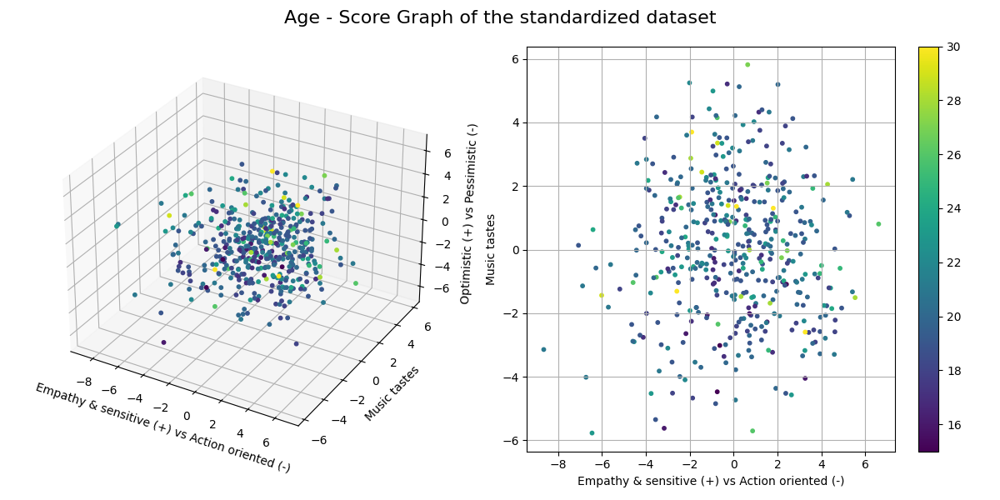

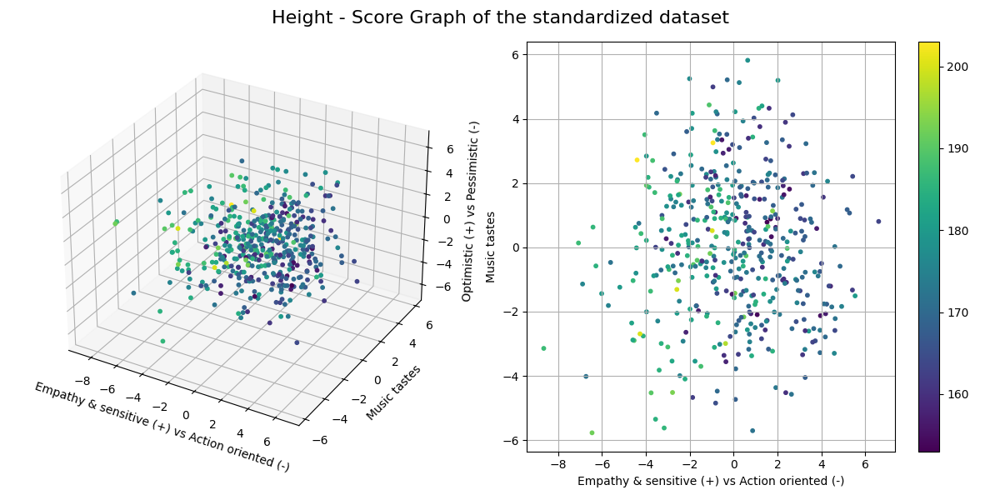

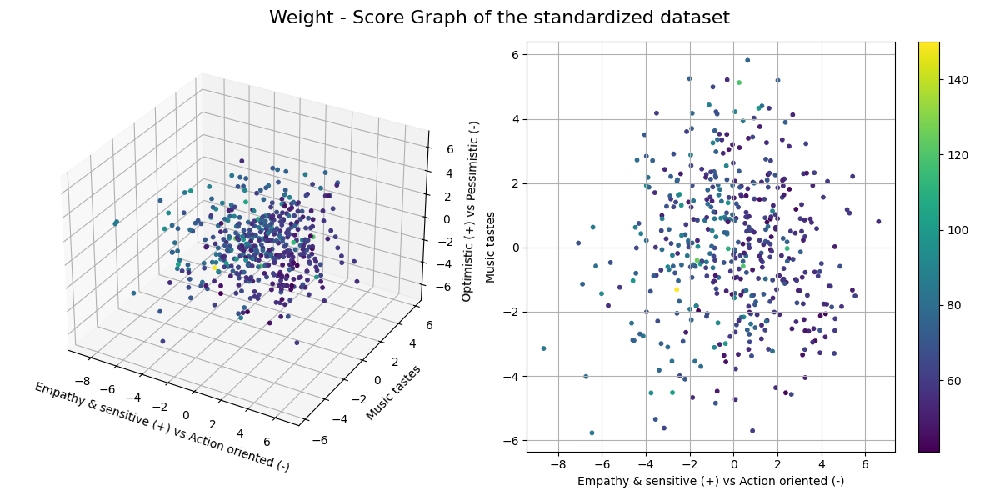

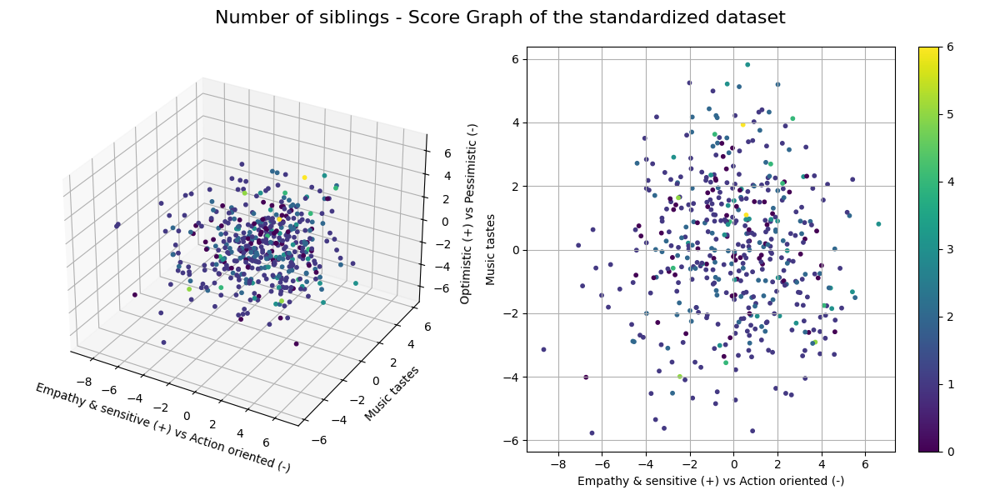

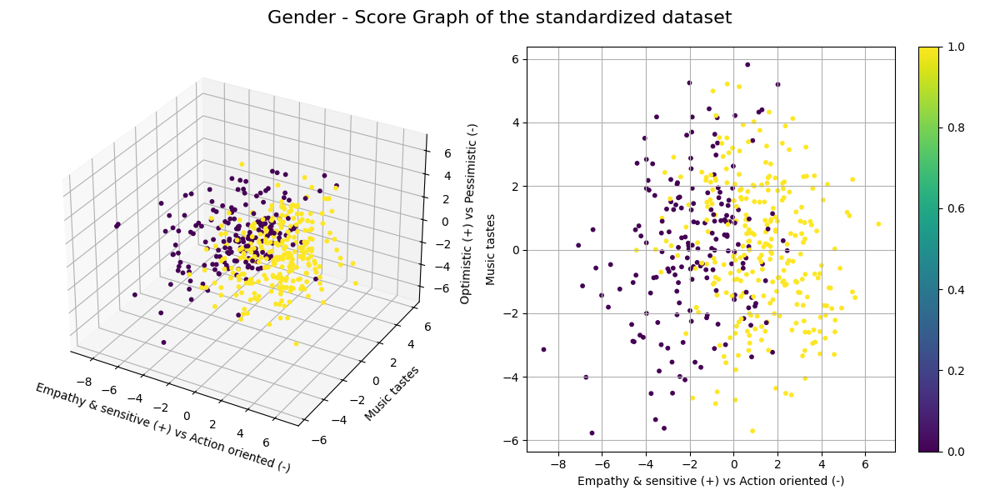

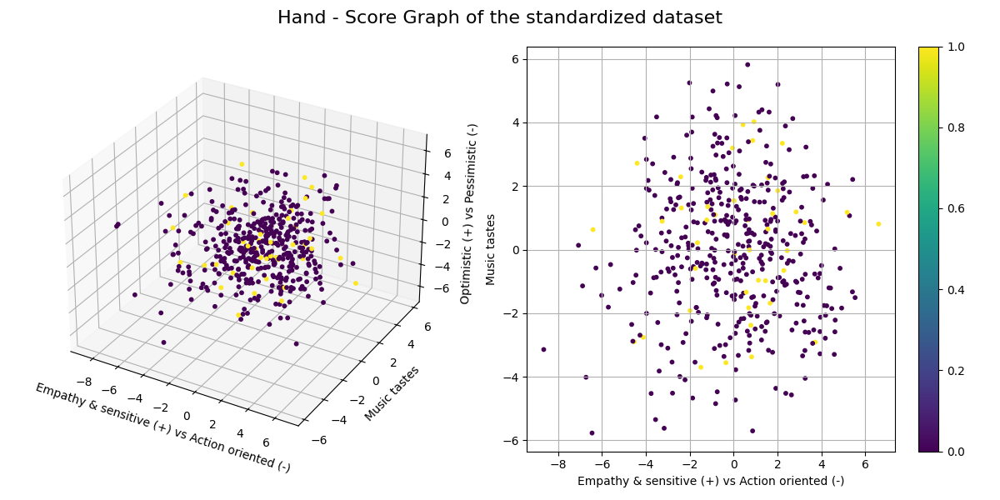

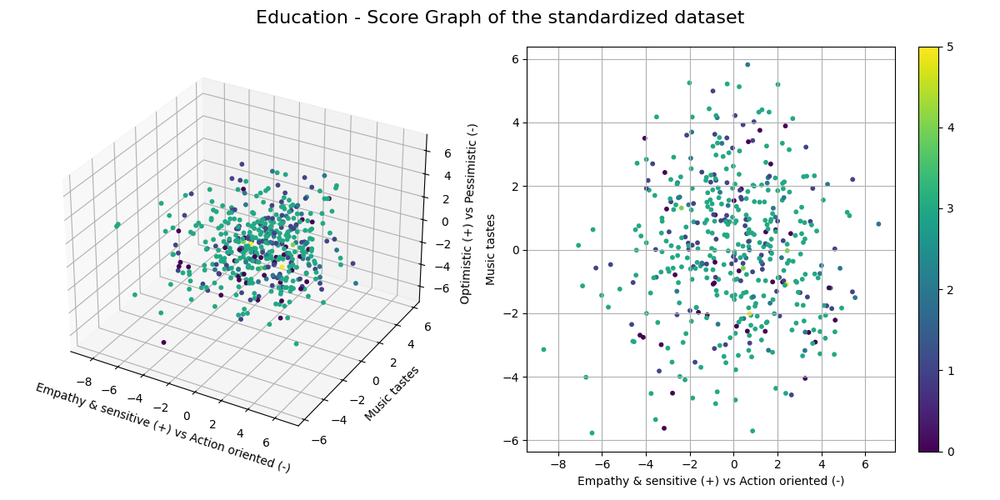

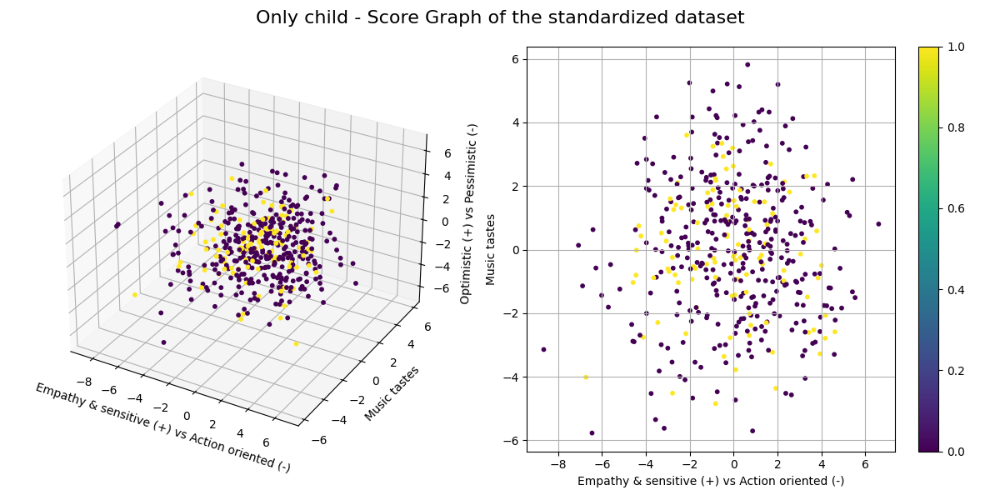

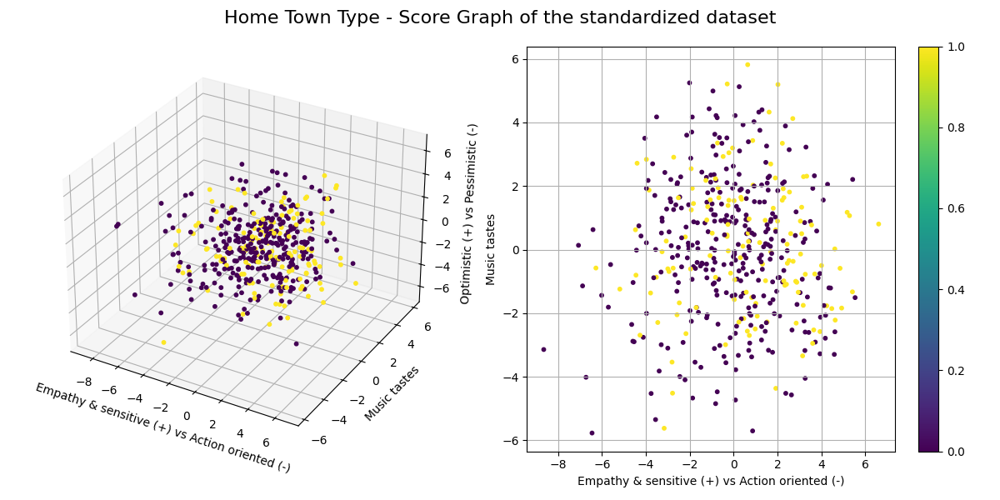

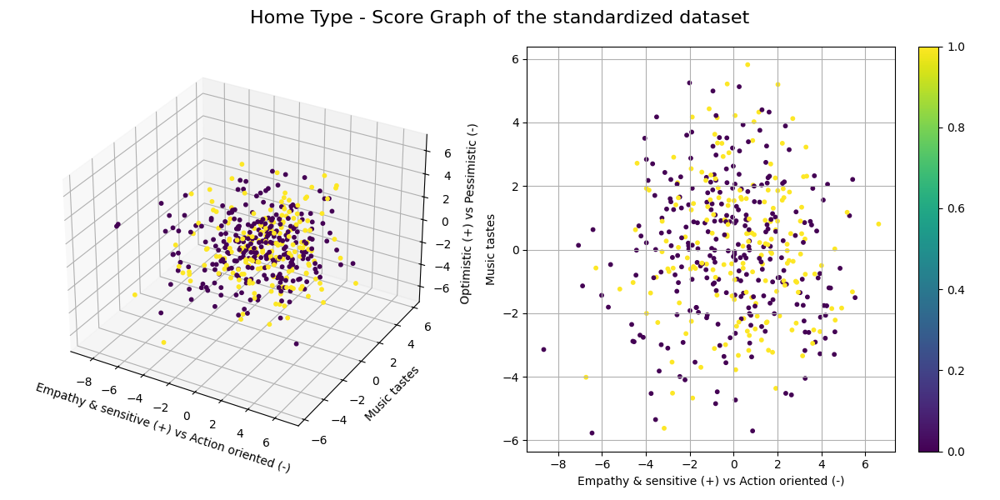

In [96]:
plot_score_graph_labels(Ystd_df, labels, pc_names_std, "standardized dataset")

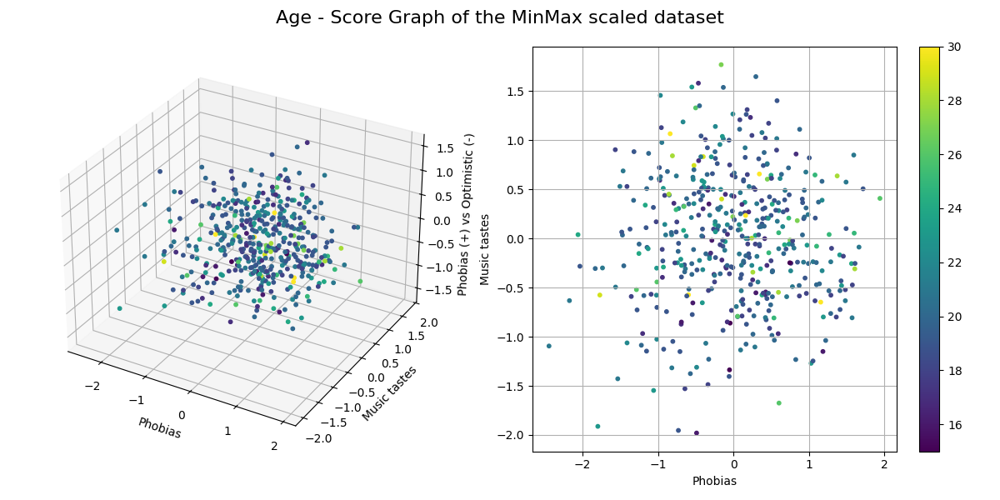

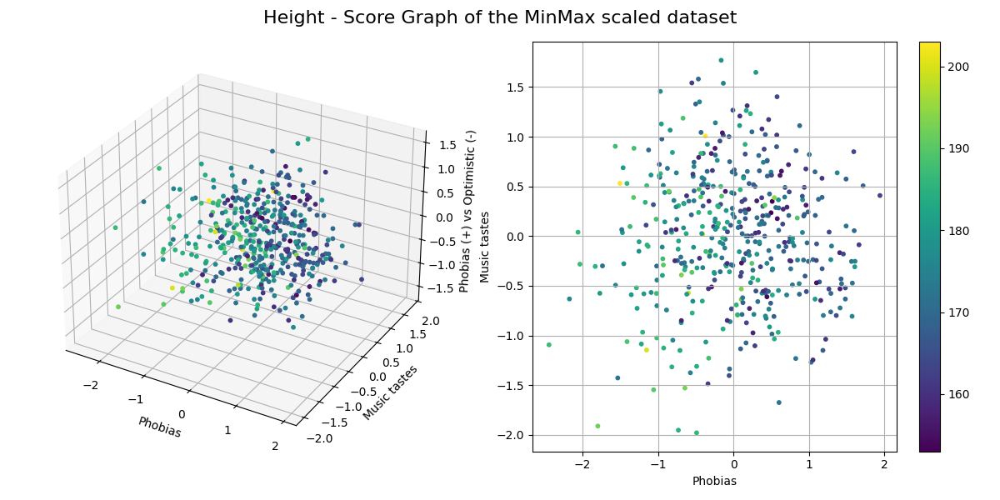

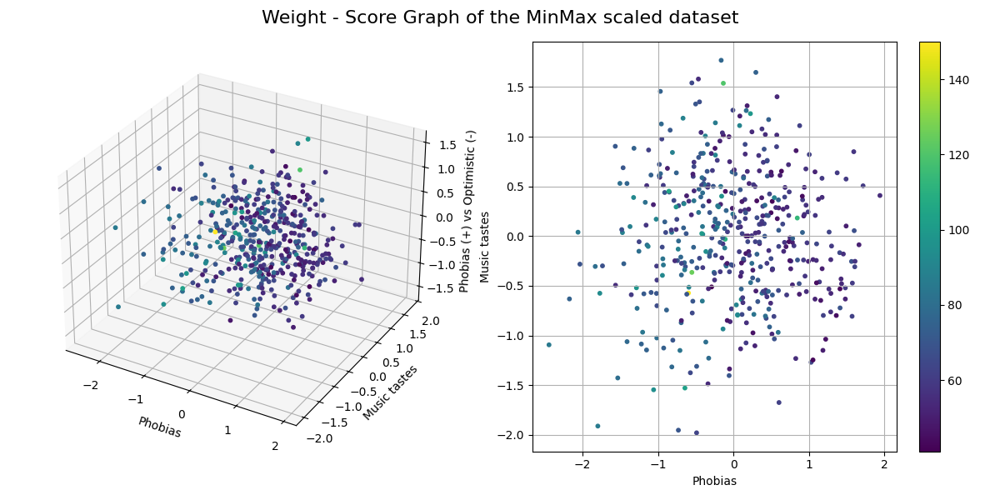

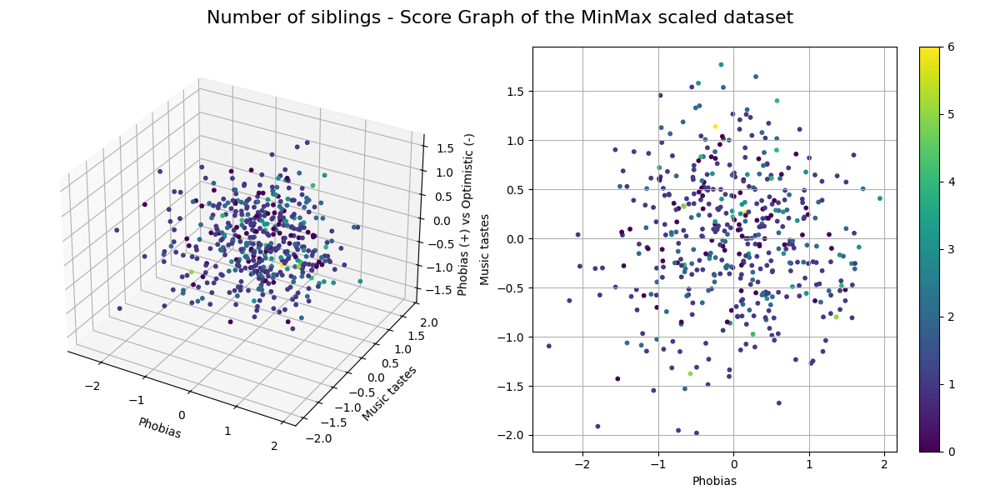

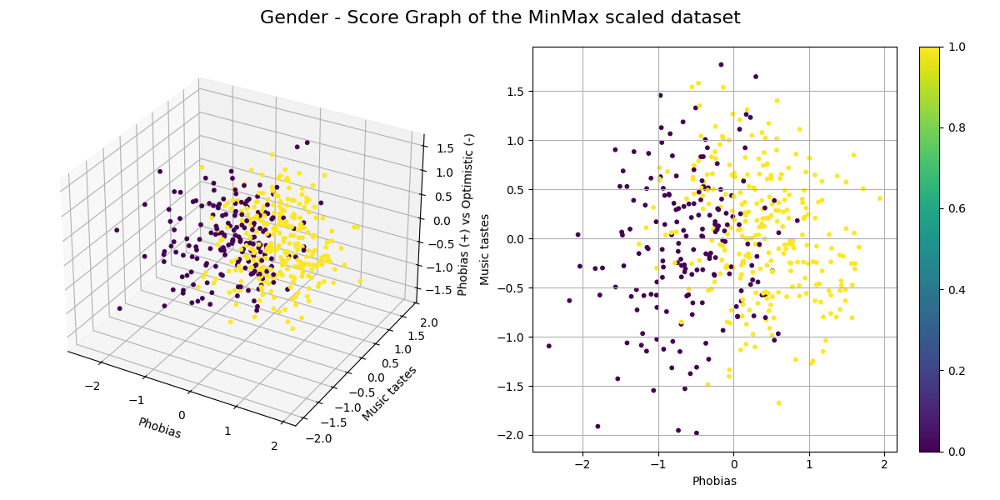

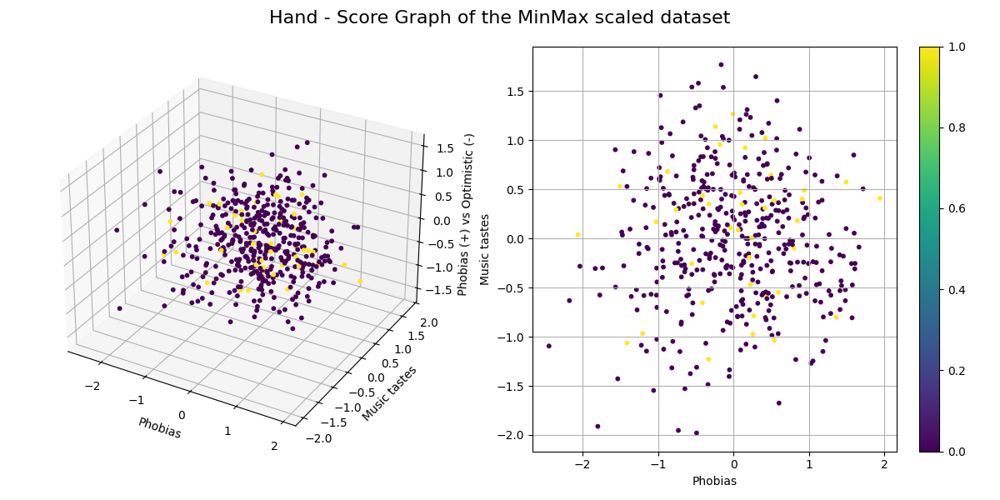

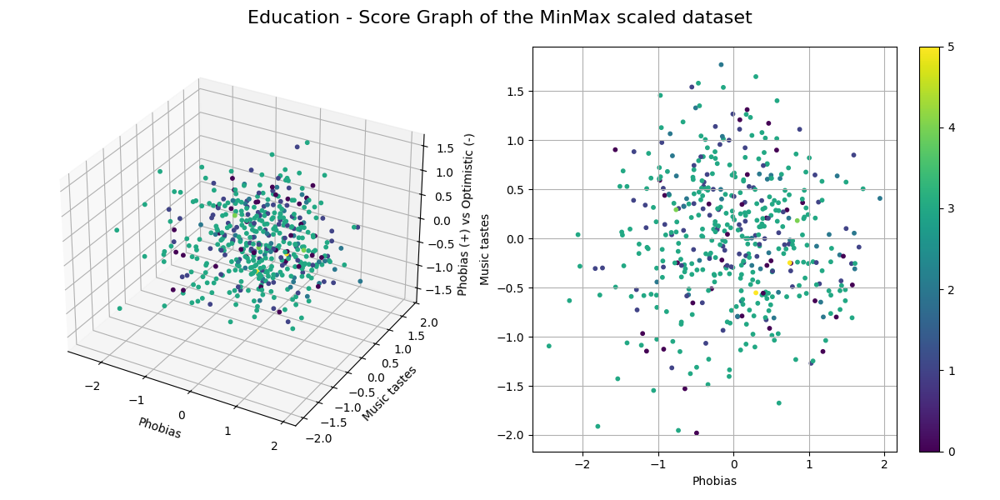

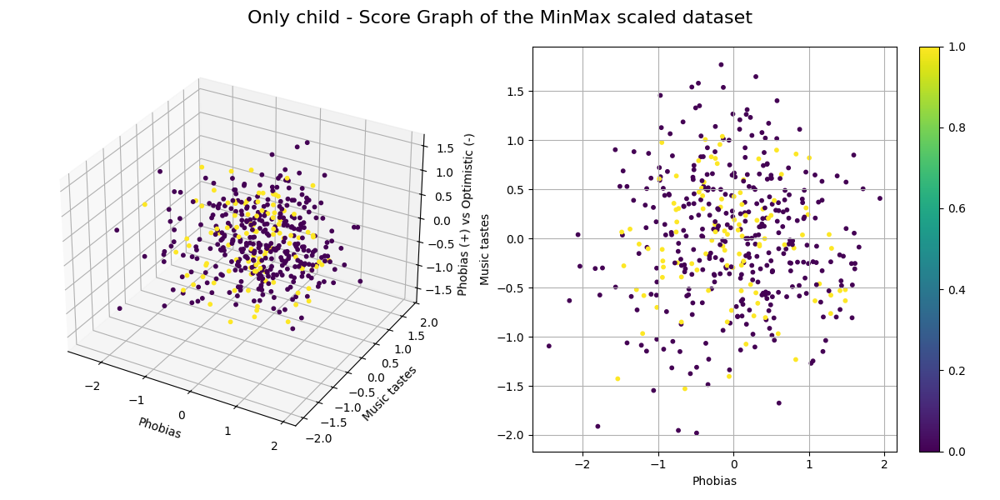

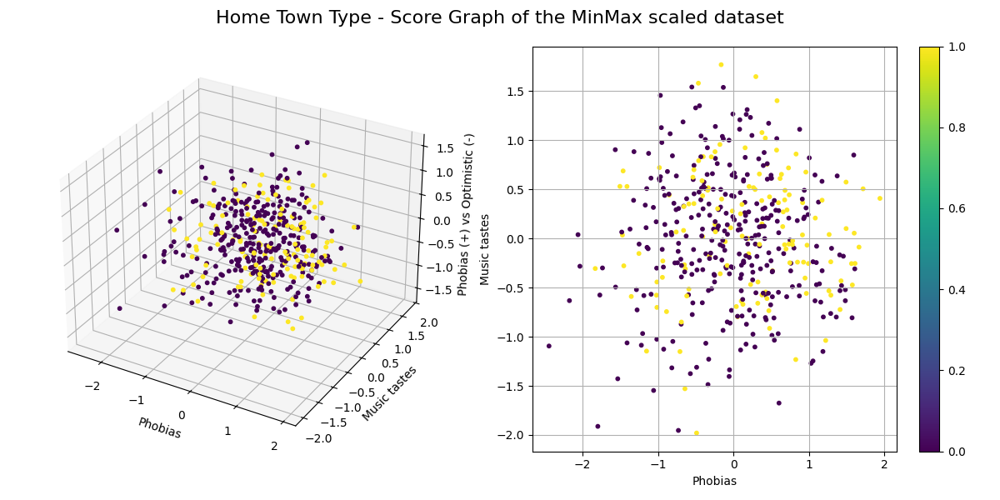

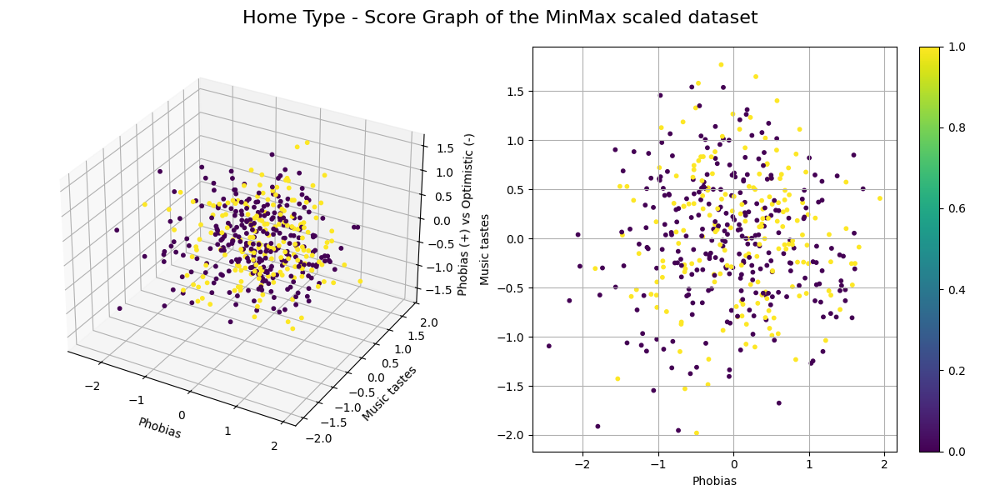

In [97]:
plot_score_graph_labels(Ymm_df, labels, pc_names_mm, "MinMax scaled dataset")

Among all the features present in demographics, the only one which gives a important visual meaning is Gender:
1. In Xstd_df females are more empathetic and creative people while males are more action oriented people
2. In Xmm_df females are full of phobias while males have less fear

## Exercise 4. $k$-Means

In the cells below, do the following operations:
1. For each one of the two datasets (_std_ and _mm_), run the $k$-Means for clustering the data. In particular, **use the silohuette score for identify the best value for $k\in\{3, \ldots, 10\}$**.
2. Plot the score graphs of exercise 3.3, adding the centroids of the cluster.
3. Observing the centroids coordinates in the PC space, **give a name/interpretation to them**, exploiting the names you assigned to the PCs. **Comment and motivate your interpretations**.

### Exercise 4.1 Run k-Means

In [98]:
def K_means(Y):
    km_list = []
    silcoeff_list = []
    k_list = list(range(3, 11))

    for i in range(len(k_list)):
        km_list.append(KMeans(n_clusters=k_list[i], n_init=10, random_state=random_seed)) 
        km_std = km_list[i]
        km_std.fit(Y)
        silcoeff_list.append(silhouette_score(Y, km_std.labels_))

    i_best = np.argmax(silcoeff_list)
    k = k_list[i_best]
    km = km_list[i_best]

    print(f'BEST SILHOUETTE SCORE: {np.max(silcoeff_list)} --> k = {k}')
    return silcoeff_list, k, km

In [99]:
silcoeff_list_std, k_std, km_std = K_means(Ystd_df)

BEST SILHOUETTE SCORE: 0.16279411897315102 --> k = 3


In [100]:
silcoeff_list_mm, k_mm, km_mm = K_means(Ymm_df)

BEST SILHOUETTE SCORE: 0.17121294403776782 --> k = 3


### Exercise 4.2 plot the score graph adding the centroids

In [101]:
def plot_centroids(Y, pc_names, km, k, title):
    fig = plt.figure(figsize=(12, 6))
    fig.suptitle(f"Score Graph with Centroids of {title}", fontsize=16)

    ax_3d = fig.add_subplot(1, 2, 1, projection='3d')
    ax_3d.scatter(Y[:, 0], Y[:, 1], Y[:, 2], s=10, alpha=0.6, c=demographics["Gender"].values)
    ax_3d.scatter(km.cluster_centers_[:, 0], km.cluster_centers_[:, 1], km.cluster_centers_[:, 2], 
                c="black", s=50, label="Centroids", alpha=1)
    for kk in range(k):
        ax_3d.text(km.cluster_centers_[kk, 0], km.cluster_centers_[kk, 1], km.cluster_centers_[kk, 2], f' clust.{kk + 1}')
    ax_3d.set_xlabel(pc_names[0])
    ax_3d.set_ylabel(pc_names[1])
    ax_3d.set_zlabel(pc_names[2])
    ax_3d.grid()

    ax_2d = fig.add_subplot(1, 2, 2)
    ax_2d.scatter(Y[:, 0], Y[:, 1], s=10, alpha=0.6, c=demographics["Gender"].values)
    ax_2d.scatter(km.cluster_centers_[:, 0], km.cluster_centers_[:, 1], c="black", s=50, label="Centroids", alpha=1)
    for kk in range(k):
        ax_2d.text(km.cluster_centers_[kk, 0], km.cluster_centers_[kk, 1], f' clust.{kk + 1}')
    ax_2d.set_xlabel(pc_names[0])
    ax_2d.set_ylabel(pc_names[1])
    ax_2d.grid()

    plt.tight_layout()
    plt.show()

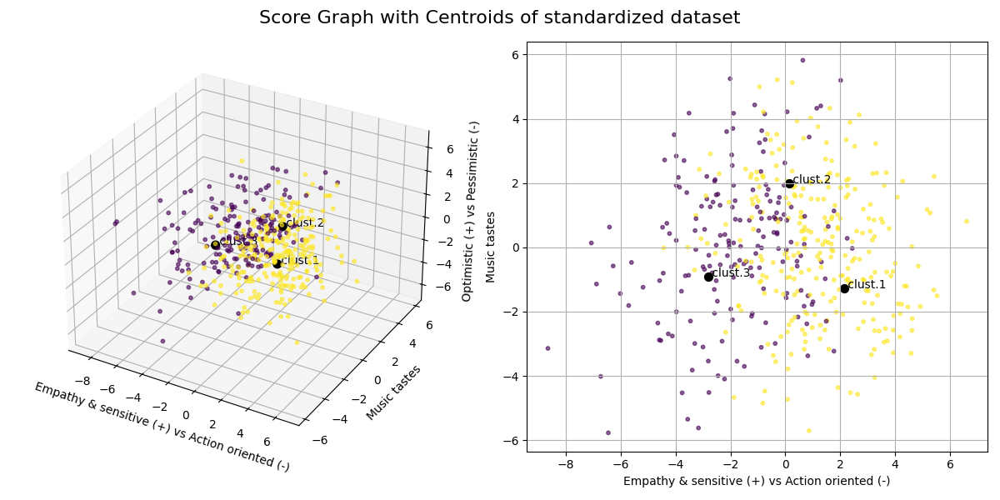

In [102]:
plot_centroids(Ystd_df, pc_names_std, km_std, k_std, "standardized dataset")

In [103]:
cluster_names_std=[
    "Empathetic & creative female",
    "Both genders with other music tastes",
    "Action oriented male"
]

Based on all the information we can extract from this graph, the best description of the centroids depends on Gender and on both PC1 and PC2:
1. The first cluster is mostly represented by females with particular music tastes: since we are at the bottom side it should be modern music genres
2. The second cluster is represented by both female and male with music tastes different from people of cluster 1 and 3. Also those people are more empathetic and sensitive even if they are male and action oriented even though they are female
3. The third cluster is mostly represented by males who are more action oriented with the same music tastes of the people in the first cluster

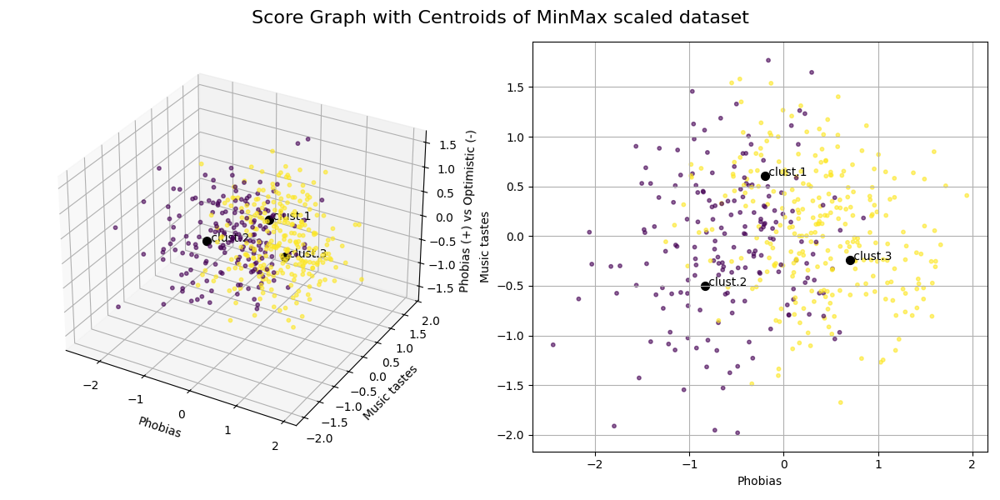

In [104]:
plot_centroids(Ymm_df, pc_names_mm, km_mm, k_mm, "MinMax scaled dataset")

In [105]:
cluster_names_mm=[
    "Both genders with other musical tastes",
    "Action oriented male",
    "Empathetic & creative female"
]

Based on all the information we can extract from this graph, the best description of the centroids depends on Gender and on both PC1 and PC2:
1. The firts cluster is represented by both female and male with music tastes different from people of cluster 1 and 3. Also those people are more empathetic and sensitive even if they are male and action oriented even though they are female
2. The second cluster is mostly represented by males who are more action oriented with the same music tastes of the people in the first cluster
3. The third cluster is mostly represented by females with particular music tastes: since we are at the bottom side it should be modern music genres

We decide to rewrite shortly pc names only to get a better visualization in the external evaluation graph.

In [106]:
pc_names_std = [
            "Empathy vs Action", 
            "Music tastes", 
            "Optimistic vs Pessimistic",
            "Bad vs Good habits",
            "Cinematic tastes"
            ]

In [107]:
pc_names_mm = [
            "Phobias",
            "Music",
            "Phobias vs Optimistic",
            "Irresponsible vs Diligent",
            "Movies"
            ]

In [108]:
def centroid_representation(Y, k, km, pc_names, cluster_names, title):
    maxs_y = Y.max(axis=0)
    mins_y = Y.min(axis=0)
    height = maxs_y - mins_y

    fig_centroids, ax_centroids = plt.subplots(2, 2, figsize=(12, 10))
    fig_centroids.suptitle(f"Interpretation of the centroids of the {title} dataset", fontsize=16)
    
    for ii in range(k):
        ir = ii // 2
        ic = ii % 2
        
        ax_centroids[ir, ic].bar(np.arange(km.cluster_centers_.shape[1]), height, bottom=mins_y, color="blue", alpha=0.15)
        ax_centroids[ir, ic].bar(np.arange(km.cluster_centers_.shape[1]), km.cluster_centers_[ii,:])

        ax_centroids[ir, ic].set_xticks(ticks=np.arange(km.cluster_centers_.shape[1]))
        ax_centroids[ir, ic].set_xticklabels(labels=pc_names, rotation=90)
        ax_centroids[ir, ic].grid(visible=True, which="both")
        ax_centroids[ir, ic].set_title(f"{cluster_names[ii]}")

    ax_centroids[1, 1].axis('off') 

    plt.tight_layout()
    plt.show()


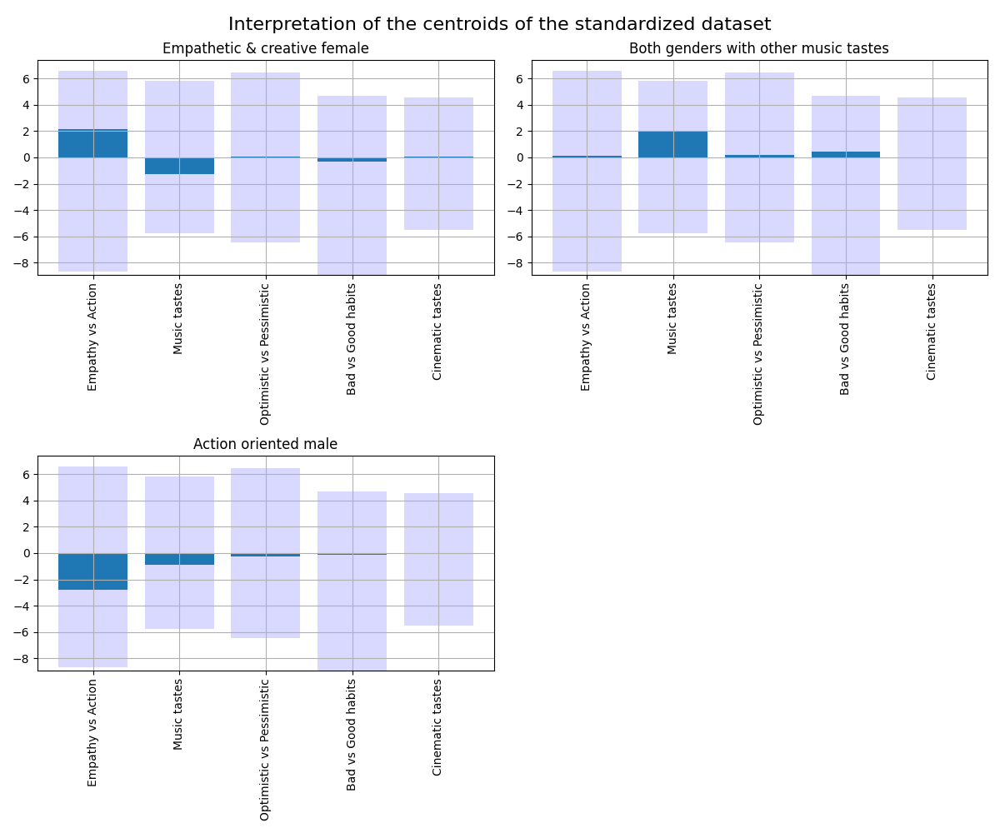

In [109]:
centroid_representation(Ystd_df, k_std, km_std, pc_names_std, cluster_names_std, "standardized")

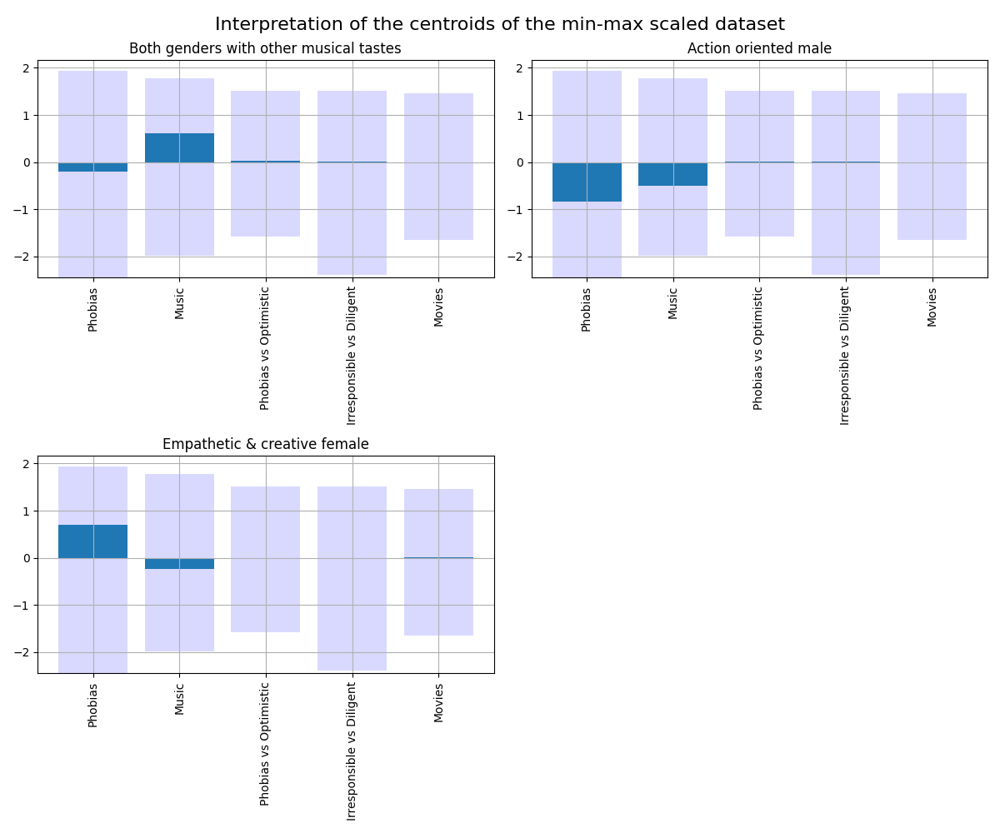

In [110]:
centroid_representation(Ymm_df, k_mm, km_mm, pc_names_mm, cluster_names_mm, "min-max scaled")

Thanks to the previous plots we can understand how centroids describe our data: the positioning of the centroids in the different bars allows us to observe how clusters differ from one another based on the main characteristics. If blue value (value of the centroid with respect to the corresponding principal component) are near to 0 and so to the middle of the range means that the cluster has characteristics that reflect average values relative to the overall population. For example, for the "Empathy vs Action" characteristic in the second plot of standardized dataframe, a centered centroid indicates that the cluster "Both genders with other  musical tastes" is neither too empathetic nor too action-oriented. 
If blue bars are far from the middle of the range means that the cluster has a strong tendency for that characteristic. For example, the value of the centroid with respect to  "Empathy vs Action" is strongly positive in the first cluster (empathetic female) and strongly negative in the third cluster (action oriented male) or the value of the cluster "Both genders with other musical tastes" with respect to "Music tastes" in the min-max scaled dataframe is far from 0 so the cluster represents people with particular music tastes with respect to the total population.

## Exercise 5. Cluster Evaluations

In the cells below, do the following operations:
1. For each one of the two datasets (_std_ and _mm_), perform an **external evaluation** of the clustering obtained at exercise 4.1 with respect to one or more labels in the list _labels_. **Comment the results, comparing the evaluation with the interpretation you gave at exercise 4.3**. 
2. For each one of the two datasets (_std_ and _mm_), perform an **internal evaluation** of each cluster, with respect to the silohuette score. **Comment the results**. 

The external evaluation of clustering is an assessment that compares the results of a clustering algorithm with an external reference or prior knowledge, such as predefined class labels or characteristics of the original data. We decide to compare the clustering with the feature Gender and we see that most of the people represented by the cluster "Empathetic & creative female" are females, the same for the cluster "Action oriented male" that represents well males. For the second cluster called "Both genders with other music tastes" that is represented by both female and male, maybe those people are more empathetic and sensitive even if they are male and action oriented even though they are female and so the clustering see those people as another group with different characteristics from the other two clusters. In this case the number of males and females is pretty equivalent.

In [111]:
def external_evaluation(km, k, cluster_names):
    mask_clusters = [km.labels_ == ii for ii in range(k)]
    cluster_genpos = [dict(demographics.loc[mask_clusters[ii], "Gender"].value_counts()) for ii in range(k)]

    bin_labels = [0, 1]
    maxcount= np.max([max(cluster_genpos[kk].values()) for kk in range(k)])

    fig_centroids_ext, ax_centroids_ext = plt.subplots(2,2,figsize=(10,10))
    for ii in range(k):
        ir=ii//2
        ic=ii%2
        ax_centroids_ext[ir,ic].bar(["male", "female"], [cluster_genpos[ii].get(bb,0) for bb in bin_labels])
        ax_centroids_ext[ir,ic].set_ylim(0, maxcount)
        ax_centroids_ext[ir,ic].grid(visible=True, which= "both")
        ax_centroids_ext[ir,ic].set_title(f"Cluster {ii+1} - {cluster_names[ii]}")
        plt.tight_layout()
        
    ax_centroids_ext[1, 1].axis('off') 

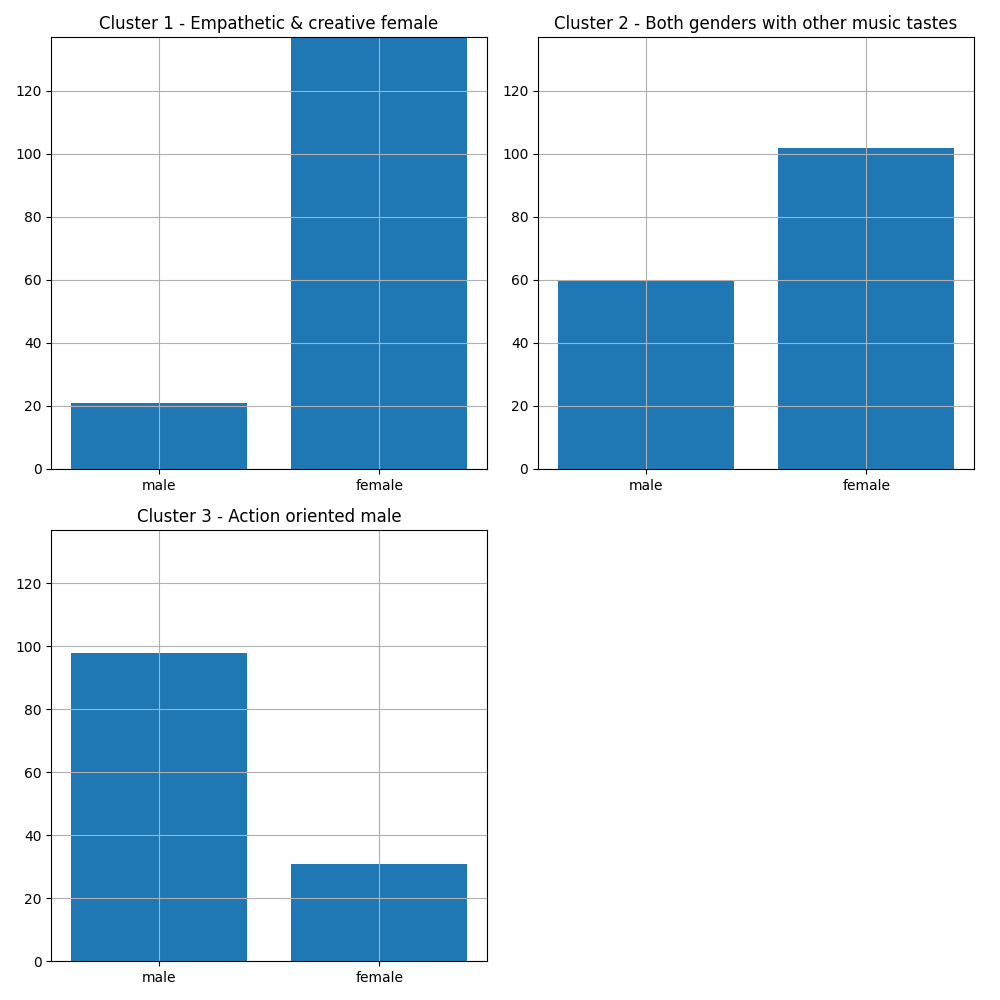

In [112]:
external_evaluation(km_std, k_std, cluster_names_std)

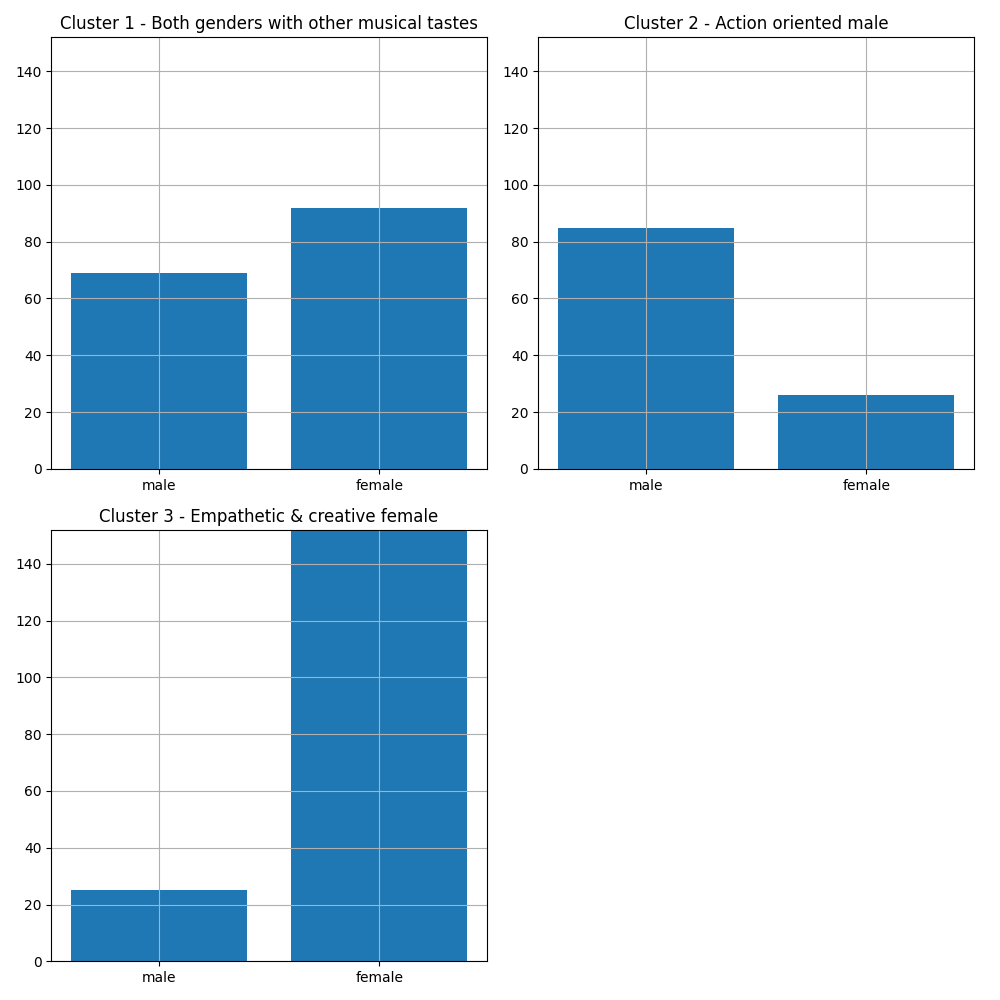

In [113]:
external_evaluation(km_mm, k_mm, cluster_names_mm)

The internal evaluation measure how much the clustering result produces clusters with high similairty within each cluster and low similarity between clusters. Some of the most used internal evaluation methods for clustering are Davies-Bouldin index, Inertia index and Silhouette Coefficient. We use the last one that compute his index thanks to the following formula:
$$ s(x) = \frac{b(x) - a(x)}{max(a(x), b(x))} $$
where $ a(x) $ is the average distance between the point x and all the points of its cluster, $ b(x) $ is the average distance between the point x and all the points of the nearest cluster. The silhouette score ranges from -1 to 1, the higher the value the better the clustering. Also the choose of the best k of kmeans has been done computing the silhouette coefficient and then selecting the max among all the computed values. 

In [114]:
def internal_evaluation(Y, km, k, silcoeff_list, cluster_names):
    silcores= silhouette_samples(Y, km.labels_)
    cluster_silscores = [np.mean(silcores[km.labels_ == kk]) for kk in range(k)]

    display(pd.DataFrame(np.array(cluster_silscores+[np.max(silcoeff_list)]), index= cluster_names + ["Global"], columns=["Sil.Score"]))

In [115]:
internal_evaluation(Ystd_df, km_std, k_std, silcoeff_list_std, cluster_names_std)

,Sil.Score
Empathetic & creative female,0.197985
Both genders with other music tastes,0.151837
Action oriented male,0.133451
Global,0.162794


In [116]:
internal_evaluation(Ymm_df, km_mm, k_mm, silcoeff_list_mm, cluster_names_mm)

,Sil.Score
Both genders with other musical tastes,0.148017
Action oriented male,0.158829
Empathetic & creative female,0.200078
Global,0.171213


### Conclusions
Based on the results of the global value of the silhouette score the clustering obtained by the min-max scaled dataframe is slightly better than the standardized dataframe but both the scores are not near to 1. This means that clusters are not so well separated. In both cases the highest value comes from "Empathetic and creative female" cluster because you have a greater discrepancy between data, and for this reason, they are more similar to each other within this cluster (i.e. almost all the points of the cluster are female). 